### Visualizacoes

Essa etapa visa criar visualizações gráficas dos dados tratados para compreender sua natureza e encontrar insights úteis. Essas visualizações facilitam a identificação de padrões, tendências e relações entre variáveis. Ao examinar os dados por meio de gráficos, podemos detectar distribuições, outliers e entender melhor seu comportamento geral. Isso é fundamental para tomadas de decisão informadas e o desenvolvimento de estratégias eficazes.

##### 1. Importar Bibliotecas

In [2]:
import pandas as pd
import datetime as dt
import numpy as np
import plotly
import seaborn as sns


import matplotlib.pyplot as plt
import plotly.express as px
import plotly.offline as py
import plotly.graph_objects as go

In [2]:
plotly.offline.init_notebook_mode(connected=True)

##### 2. Importar base de dados

In [3]:
crimes_selecionados_belem_df = pd.read_csv('C:\\Users\\carlo\\Downloads\\crimes_selecionados_belem.csv')

In [4]:
crimes_selecionados_belem_df.shape

(47607, 21)

##### 3. Gráficos 


* **Tipos de violência mais frequentes**

Para uma melhor visualização, alguns crimes da coluna "consolidado" serão agrupados de acordo com  tipo de violência contra a mulher

A Lei Maria da Penha (Lei nº 11.340/2006) classifica e especifica os tipos de violência domestica contra a mulher, e o Art. 7º enumera algumas das formas de violências que as mulheres podem sofrer. São elas, dentre outras, as violências física, psicológica, sexual, patrimonial ou sexual.

Portanto os crimes serão agrupados da seguinte forma:
1. **Violência Física:**
    - Lesão corporal
    - Homicídio
    - Tentativa de homicídio
    - Tentativa de feminicídio
    - Violência física
    - Feminicídio
2. **Violência Sexual:**
    - Estupro de vulnerável
    - Importunação sexual
    - Assédio sexual
    - Violência sexual
    - Estupro
    - Violação sexual
3. **Violência Psicológica/Emocional:**
    - Violência psicológica
    - Assédio
    - Ameaça
4. **Violência patrimonial:**
    - Violência patrimonial
5. Violência moral:
    - Violência moral
6. **Outros:**
    - Descumprimento de medidas protetivas
    - Descumprimento de medidas protetivas de urgência
    - Violência doméstica

In [68]:
import os

if not os.path.exists("imagens"):
    os.mkdir("imagens")

In [36]:
custom_palette= ['#9c0f48','#6FCF97', '#633a82','#ea5f2d' ,'#9F7FBA','#548e87', '#e84a5f', '#4682B4']

* **Tipos de crimes mais frequêntes**

In [69]:
tipos_crimes = crimes_selecionados_belem_df.copy()
mapeamento_crimes = {
    'LESAO CORPORAL': 'Violência Física',                                 
    'HOMICIDIO': 'Violência Física',
    'FEMINICIDIO': 'Violência Física',
    'TENTATIVA DE HOMICIDIO': 'Violência Física',
    'TENTATIVA DE FEMINICIDIO': 'Violência Física',
    'VIOLENCIA FISICA': 'Violência Física',

    'ESTUPRO': 'Violência Sexual',
    'ESTUPRO DE VULNERAVEL': 'Violência Sexual',
    'IMPORTUNACAO SEXUAL': 'Violência Sexual',
    'ASSEDIO SEXUAL': 'Violência Sexual',
    'VIOLACAO SEXUAL': 'Violência Sexual',
    'VIOLENCIA FISICA': 'Violência Sexual',

    'AMEACA': 'Violência Psicológica',
    'VIOLENCIA PSICOLOGICA': 'Violência Psicológica',
    'ASSEDIO': 'Violência Psicológica',

    'VIOLENCIA PATRIMONIAL': 'Violência Patrimonial',

    'VIOLENCIA MORAL': 'Violência Moral',

    'DESCUMPRIMENTO DE MEDIDAS PROTETIVAS': 'Outros',
    'DESCUMPRIMENTO DE MEDIDAS PROTETIVAS DE URGENCIA': 'Outros',
    'VIOLENCIA DOMESTICA': 'Outros'
}
tipos_crimes['Tipos'] = tipos_crimes['consolidado'].map(mapeamento_crimes)
frequencia_crimes = tipos_crimes['Tipos'].value_counts()


In [71]:
fig = go.Figure(data=[go.Pie(labels=frequencia_crimes.index, values=frequencia_crimes.values,marker=dict(colors=custom_palette))])

fig.update_layout(title= 'Tipos de crime mais frequêntes contra a mulher',
                  scene=dict(aspectmode="cube"),
                  width=750,  
                  height=500,
        plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE'))

fig.update_traces(marker=dict(line=dict(color='white', width=2)),
                  textfont=dict(size=15))

py.iplot(fig)
fig.write_image("imagens/tipos_crimes.svg")

In [9]:
frquencia_tipos = tipos_crimes[['ano_fato', 'Tipos']].copy()

In [10]:
agrupado_tipos = frquencia_tipos.groupby(['ano_fato', 'Tipos']).size().reset_index(name='ocorrencias')
agrupado_tipos

,ano_fato,Tipos,ocorrencias
0,2019,Outros,294
1,2019,Violência Física,3556
2,2019,Violência Moral,19
3,2019,Violência Psicológica,5052
4,2019,Violência Sexual,556
5,2020,Outros,2
6,2020,Violência Física,2924
7,2020,Violência Moral,24
8,2020,Violência Psicológica,5444
9,2020,Violência Sexual,586


In [11]:
fig = px.line(agrupado_tipos, x='ano_fato',y='ocorrencias', color='Tipos', markers=True, symbol="Tipos",
                     labels={
                     "Tipos": "Tipos de violencia",
                     "ano_fato": "Ano"
                 }, height=500, width=750,
                 color_discrete_sequence= custom_palette)

fig.update_layout(
    title='Frequência de registro de ocorrências ao longo dos anos', 
    plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE')
)

fig.update_yaxes(title='Frequência')
fig.update_traces(line=dict(width=3)) 


fig.show()

In [38]:
fig = px.histogram(tipos_crimes, x="ano_fato",
             color='Tipos', title= "Frequência dos crimes ocorridos por ano",
             text_auto='.3s', height=500, width=750, labels={
                     "Tipos": "Tipos de crimes",
                     "ano_fato": "Anos"
                 },
                 color_discrete_sequence=custom_palette)

fig.update_xaxes(tickangle=0)

fig.update_layout(barmode='group', 
                  xaxis={'categoryorder':'total descending'}, 
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  legend=dict(bgcolor='#FFF5EE'))
py.iplot(fig)

* **Crimes mais frequentes**

In [251]:
crimes_frequentes = crimes_selecionados_belem_df['consolidado'].value_counts().head(5)
fig = go.Figure(data=[go.Pie(labels=crimes_frequentes.index, values=crimes_frequentes.values,marker=dict(colors=custom_palette))])

fig.update_layout(title= 'Tipos de crime mais frequêntes contra a mulher',
                  scene=dict(aspectmode="cube"),
                  width=750,  
                  height=500,
    plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE'))

fig.update_traces(marker=dict(line=dict(color='white', width=2)),
                  textfont=dict(size=15))

py.iplot(fig)

* **Crimes mais frequentes por tipos de violencia**

In [186]:
frequencia_crimes = tipos_crimes.groupby(['consolidado', 'Tipos']).size().reset_index(name='Freq')
frequencia_crimes_top3 = frequencia_crimes.groupby('Tipos').apply(lambda x: x.nlargest(2, 'Freq')).reset_index(drop=True)

max_depth = 2
fig = px.sunburst(frequencia_crimes_top3, path=['Tipos', 'consolidado'], values='Freq', color_discrete_sequence= custom_palette,maxdepth=max_depth,  branchvalues='remainder', width=750, height=500)

fig.show()


In [191]:
top_tipos_violencia = tipos_crimes['Tipos'].value_counts().head(3).index
tipos_crimes_top3 = tipos_crimes[tipos_crimes['Tipos'].isin(top_tipos_violencia)]

frequencia_crimes_top3 = tipos_crimes_top3.groupby(['Tipos', 'consolidado']).size().reset_index(name='Freq')
frequencia_crimes_top3 = frequencia_crimes_top3.groupby('Tipos').apply(lambda x: x.nlargest(2, 'Freq')).reset_index(drop=True)

fig = px.sunburst(frequencia_crimes_top3,
                  path=['Tipos', 'consolidado'],
                  values='Freq',
                  branchvalues='total',
                  color_discrete_sequence=custom_palette,
                  width=750,
                  height=500)

# Exibindo o gráfico
fig.show()


* **Crimes mais recorrentes ao longo dos anos**

In [13]:
crimes_selecionados_belem_df.consolidado.value_counts()

consolidado
AMEACA                                              27032
LESAO CORPORAL                                      15023
ESTUPRO DE VULNERAVEL                                1916
IMPORTUNACAO SEXUAL                                  1389
VIOLENCIA PSICOLOGICA                                1124
DESCUMPRIMENTO DE MEDIDAS PROTETIVAS                  321
ASSEDIO SEXUAL                                        222
VIOLENCIA MORAL                                       142
HOMICIDIO                                             131
TENTATIVA DE HOMICIDIO                                100
TENTATIVA DE FEMINICIDIO                               94
VIOLENCIA PATRIMONIAL                                  37
VIOLENCIA FISICA                                       25
FEMINICIDIO                                            23
VIOLACAO SEXUAL                                        14
DESCUMPRIMENTO DE MEDIDAS PROTETIVAS DE URGENCIA        6
VIOLENCIA DOMESTICA                                     3
ES

In [29]:
df1 = crimes_selecionados_belem_df[crimes_selecionados_belem_df['consolidado'].isin(crimes_selecionados_belem_df['consolidado'].value_counts().head(5).index)]
agrupado_periodo = df1.groupby(['consolidado', 'ano_fato']).size().reset_index(name='ocorrencias')
agrupado_periodo

,consolidado,ano_fato,ocorrencias
0,AMEACA,2019,4999
1,AMEACA,2020,5333
2,AMEACA,2021,5802
3,AMEACA,2022,5183
4,AMEACA,2023,5715
5,ESTUPRO DE VULNERAVEL,2019,319
6,ESTUPRO DE VULNERAVEL,2020,294
7,ESTUPRO DE VULNERAVEL,2021,411
8,ESTUPRO DE VULNERAVEL,2022,415
9,ESTUPRO DE VULNERAVEL,2023,477


In [30]:
fig = px.line(agrupado_periodo, x='ano_fato',y='ocorrencias', color='consolidado', markers=True, symbol="consolidado",
                     labels={
                     "consolidado": "Crimes",
                     "ano_fato": "Ano"
                 }, height=500, width=750,
                 color_discrete_sequence= custom_palette)

fig.update_layout(
    title='Frequência de registro de ocorrências ao longo dos anos', 
    plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE')
)

fig.update_yaxes(title='Frequência')

fig.show()

In [33]:
fig = px.histogram(df1, x="ano_fato",
             color='consolidado', title= "Frequência dos crimes ocorridos por ano",
             text_auto='.3s', height=500, width=750, labels={
                     "consolidado": "Tipos de crimes",
                     "ano_fato": "Anos"
                 },
                 color_discrete_sequence=custom_palette)

fig.update_xaxes(tickangle=0)

fig.update_layout(barmode='group', 
                  xaxis={'categoryorder':'total descending'}, 
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  legend=dict(bgcolor='#FFF5EE'))
py.iplot(fig)

In [34]:
df2 = crimes_selecionados_belem_df.loc[crimes_selecionados_belem_df['consolidado'].isin(["ESTUPRO DE VULNERAVEL", "IMPORTUNACAO SEXUAL", "VIOLENCIA PSICOLOGICA"])]

fig = px.histogram(df2, x="ano_fato",
             color='consolidado', title= "Frequência dos crimes ocorridos por ano",
             text_auto='.3s', height=500, width=750, labels={
                     "consolidado": "Tipos de crimes",
                     "ano_fato": "Anos"
                 },
                 color_discrete_sequence=custom_palette)

fig.update_xaxes(tickangle=0)

fig.update_layout(barmode='group', 
                  xaxis={'categoryorder':'total descending'}, 
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  legend=dict(bgcolor='#FFF5EE'))
py.iplot(fig)

In [35]:
df_filtro_crimes = crimes_selecionados_belem_df.groupby(['ano_fato','consolidado']).size().unstack(fill_value=0)
df_filtro_crimes.sort_index(ascending=True)

consolidado,AMEACA,ASSEDIO,ASSEDIO SEXUAL,DESCUMPRIMENTO DE MEDIDAS PROTETIVAS,DESCUMPRIMENTO DE MEDIDAS PROTETIVAS DE URGENCIA,ESTUPRO,ESTUPRO DE VULNERAVEL,FEMINICIDIO,HOMICIDIO,IMPORTUNACAO SEXUAL,LESAO CORPORAL,TENTATIVA DE FEMINICIDIO,TENTATIVA DE HOMICIDIO,VIOLACAO SEXUAL,VIOLENCIA DOMESTICA,VIOLENCIA FISICA,VIOLENCIA MORAL,VIOLENCIA PATRIMONIAL,VIOLENCIA PSICOLOGICA,VIOLENCIA SEXUAL
ano_fato,,,,,,,,,,,,,,,,,,,,
2019,4999,0,36,294,0,1,319,3,44,195,3462,21,26,4,0,1,19,0,53,0
2020,5333,2,41,1,0,1,294,4,27,230,2857,13,23,4,1,16,24,0,109,0
2021,5802,0,47,1,0,0,411,8,24,289,2786,16,11,4,2,8,36,7,187,1
2022,5183,0,45,0,6,0,415,3,18,290,2779,14,14,0,0,0,54,30,361,0
2023,5715,0,53,25,0,0,477,5,18,385,3139,30,26,2,0,0,9,0,414,0


* **Tipificação dos crimes mais frequentes**

In [39]:
crimes_selecionados_belem_df.especificacao_crime.value_counts()

especificacao_crime
Nao informado                                            31271
VIOLENCIA DOMESTICA                                      14133
MENOR                                                      631
PREJUDICADO                                                546
CRIMES VIRTUAIS                                            210
                                                         ...  
ERRO SOBRE A PESSOA                                          1
DISPARO DE ARMA DE FOGO                                      1
MENOR/ERA DO FATO/COMUNICACAO                                1
CHOQUE COM OBJETO FIXO                                       1
EM ESTABELECIMENTO DE ENSINO/DOCENTE/AMEACA DE ATAQUE        1
Name: count, Length: 96, dtype: int64

In [40]:
df_especifico = crimes_selecionados_belem_df.loc[crimes_selecionados_belem_df['especificacao_crime'].isin(['VIOLENCIA DOMESTICA', 'MENOR', 'CRIMES VIRTUAIS'])]

fig = px.histogram(df_especifico, y="ano_fato",
             color='especificacao_crime', 
             barmode='group',
             title= "Frequência dos crimes ocorridos por ano",
             text_auto='.3s', height=500, width=750, labels={
                     "especificacao_crime": "Tipos de crimes",
                     "ano_fato": "Anos"
                 },
                 color_discrete_sequence=custom_palette)

fig.update_xaxes(tickangle=0)

fig.update_layout(xaxis={'categoryorder':'total descending'},
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  legend=dict(bgcolor='#FFF5EE'))
py.iplot(fig)

* **Frequência dos crimes em ralação ao turno**

In [42]:
fig = px.histogram(crimes_selecionados_belem_df, x="turno", title= "Frequência do turno do dia dos crimes",
             text_auto='.2s', category_orders={"turno":['MANHA', 'TARDE', 'NOITE', 'MADRUGADA']}, height=500, width=750,
             labels={
                     "turno": "Períodos do dia"
                 },
                color_discrete_sequence=custom_palette
                )

fig.update_layout(xaxis={'categoryorder':'total descending'},
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  legend=dict(bgcolor='#FFF5EE'))

fig.update_xaxes(title='Periodo do dia')

py.iplot(fig)

In [44]:
fig = px.histogram(df1, x="turno",
             color='consolidado', title= "Frequência do turno do dia dos crimes",
             text_auto='.2s',category_orders={"turno":['MANHA', 'TARDE', 'NOITE', 'MADRUGADA']}, height=500, width=750,
             labels={
                     "consolidado": "Tipos de crimes",
                     "turno": "Períodos do dia"
                 }, 
                color_discrete_sequence=custom_palette)


fig.update_xaxes(tickangle=0, categoryorder='array')

fig.update_layout(xaxis={'categoryorder':'total descending'},
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white',
                  barmode='group', 
                  legend=dict(bgcolor='#FFF5EE'))
fig.update_yaxes(title='Frequência')

py.iplot(fig)

In [48]:
fig = px.histogram(df2, x="turno",
             color='consolidado', title= "Frequência do turno do dia dos crimes",
             text_auto='.3s', height=500, width=750,
             labels={
                     "consolidado": "Tipos de crimes",
                     "turno": "Períodos do dia"
                 }, 
                category_orders={"turno":['MANHA', 'TARDE', 'NOITE', 'MADRUGADA']},
                color_discrete_sequence=custom_palette)

fig.update_xaxes(tickangle=0, categoryorder='array')
fig.update_layout(xaxis={'categoryorder':'total descending'},
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  barmode='group',
                  legend=dict(bgcolor='#FFF5EE'))
fig.update_yaxes(title='Frequência')

py.iplot(fig)

* **Frequência dos crimes ocorridos por dia da semana**

In [49]:
fig = px.histogram(crimes_selecionados_belem_df, x="dia_semana",
            title= "Frequência dos crimes ocorridos por dia da semana",
             text_auto='.2s', height=500, width=750, labels={
                     "dia_semana": "Dias da semana"
                 },
             category_orders={"dia_semana":['SEG', 'TER', 'QUA', 'QUI', 'SEX', 'SAB', 'DOM']},
             color_discrete_sequence=custom_palette
                )           
fig.update_xaxes(tickangle=0, categoryorder='array')
fig.update_layout(xaxis={'categoryorder':'total descending'},
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  legend=dict(bgcolor='#FFF5EE'))
py.iplot(fig)

In [50]:
df_filtro_semana = crimes_selecionados_belem_df.groupby(['ano_fato','dia_semana']).size().unstack(fill_value=0)
df_filtro_semana.sort_index(ascending=True)

dia_semana,DOM,QUA,QUI,SAB,SEG,SEX,TER
ano_fato,,,,,,,
2019,1764,1277,1172,1311,1485,1236,1232
2020,1659,1305,1136,1234,1319,1196,1131
2021,1783,1343,1202,1327,1399,1309,1277
2022,1575,1292,1276,1234,1432,1139,1264
2023,1787,1386,1293,1430,1614,1325,1463


In [53]:
fig = px.histogram(df1, x="dia_semana",
             color='consolidado', title= "Frequência dos crimes ocorridos por dia da semana",
             text_auto='.2s', height=500, width=750, labels={
                     "consolidado": "Tipos de crimes",
                     "dia_semana": "Dias da semana"
                 },
             category_orders={"dia_semana":['SEG', 'TER', 'QUA', 'QUI', 'SEX', 'SAB', 'DOM']},
             color_discrete_sequence=custom_palette
                )           

fig.update_layout(xaxis={'categoryorder':'total descending'},
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  barmode ='stack',
                  legend=dict(bgcolor='#FFF5EE'))
py.iplot(fig)

In [54]:
fig = px.histogram(df2, x="dia_semana",
             color='consolidado', title= "Frequência dos crimes ocorridos por dia da semana",
             text_auto='.2s', height=500, width=750, labels={
                     "consolidado": "Tipos de crimes",
                     "dia_semana": "Dias da semana"
                 },
             category_orders={"dia_semana":['SEG', 'TER', 'QUA', 'QUI', 'SEX', 'SAB', 'DOM']},
             color_discrete_sequence=custom_palette
                )           

fig.update_layout(xaxis={'categoryorder':'total descending'},
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  barmode = 'stack',
                  legend=dict(bgcolor='#FFF5EE'))
py.iplot(fig)

* **Frequência dos crimes ocorridos por período do ano**

In [56]:
fig = px.histogram(crimes_selecionados_belem_df, y='periodo',   
                   title='Frequência de Crimes por Período do Ano',
                   height=500, width=750, 
                   barmode='group',
                   category_orders={"periodo":['1 SEMESTRE DE 2019', '2 SEMESTRE DE 2019', '1 SEMESTRE DE 2020', '2 SEMESTRE DE 2020', '1 SEMESTRE DE 2021', '2 SEMESTRE DE 2021','1 SEMESTRE DE 2022', '2 SEMESTRE DE 2022', '1 SEMESTRE DE 2023', '2 SEMESTRE DE 2023']},
                   color_discrete_sequence=custom_palette
                   )
fig.update_layout(xaxis={'categoryorder':'total descending'},
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  legend=dict(bgcolor='#FFF5EE'))

py.iplot(fig)

In [82]:
fig = px.histogram(df1, y='periodo', color='consolidado',   
                   title='Frequência de Crimes por Período do Ano',
                   height=500, width=750, 
                   barmode='stack',
                   category_orders={"periodo":['1 SEMESTRE DE 2019', '2 SEMESTRE DE 2019', '1 SEMESTRE DE 2020', '2 SEMESTRE DE 2020', '1 SEMESTRE DE 2021', '2 SEMESTRE DE 2021','1 SEMESTRE DE 2022', '2 SEMESTRE DE 2022', '1 SEMESTRE DE 2023', '2 SEMESTRE DE 2023']},
                   color_discrete_sequence=custom_palette
                   )
fig.update_layout(xaxis={'categoryorder':'total descending'},
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  legend=dict(bgcolor='#FFF5EE'))

py.iplot(fig)

In [84]:
df3 = crimes_selecionados_belem_df[crimes_selecionados_belem_df['consolidado'].isin(crimes_selecionados_belem_df['consolidado'].value_counts().head(3).index)]
fig = px.histogram(df3, y='periodo', color='consolidado', 
                    height=500, width=750, 
                   barmode='stack',
                   category_orders={"periodo":['1 SEMESTRE DE 2019', '2 SEMESTRE DE 2019', '1 SEMESTRE DE 2020', '2 SEMESTRE DE 2020', '1 SEMESTRE DE 2021', '2 SEMESTRE DE 2021','1 SEMESTRE DE 2022', '2 SEMESTRE DE 2022', '1 SEMESTRE DE 2023', '2 SEMESTRE DE 2023']},                  
                   color_discrete_sequence=custom_palette
                   )
fig.update_layout(xaxis={'categoryorder':'total descending'},
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  legend=dict(bgcolor='#FFF5EE'))

py.iplot(fig)

In [85]:
filtro_crimes_frequentes = crimes_selecionados_belem_df[crimes_selecionados_belem_df['consolidado'].isin(crimes_selecionados_belem_df['consolidado'].value_counts().head(5).index)]
filtro_crimes_frequentes=filtro_crimes_frequentes.groupby(['consolidado','periodo']).size().unstack(fill_value=0)
filtro_crimes_frequentes.sort_index(ascending=True)

periodo,1 SEMESTRE DE 2019,1 SEMESTRE DE 2020,1 SEMESTRE DE 2021,1 SEMESTRE DE 2022,1 SEMESTRE DE 2023,2 SEMESTRE DE 2019,2 SEMESTRE DE 2020,2 SEMESTRE DE 2021,2 SEMESTRE DE 2022,2 SEMESTRE DE 2023
consolidado,,,,,,,,,,
AMEACA,2531,2471,2931,2591,2973,2468,2862,2871,2592,2742
ESTUPRO DE VULNERAVEL,163,125,175,180,264,156,169,236,235,213
IMPORTUNACAO SEXUAL,73,82,144,130,196,122,148,145,160,189
LESAO CORPORAL,1728,1224,1361,1320,1533,1734,1633,1425,1459,1606
VIOLENCIA PSICOLOGICA,31,25,29,162,256,22,84,158,199,158


* **Crimes ao longo dos anos**

In [86]:
df_mes = crimes_selecionados_belem_df[['ano_fato', 'mes_fato', 'consolidado']].copy()
df_mes.head()

,ano_fato,mes_fato,consolidado
0,2019,FEVEREIRO,AMEACA
1,2019,JANEIRO,LESAO CORPORAL
2,2019,NOVEMBRO,AMEACA
3,2019,NOVEMBRO,LESAO CORPORAL
4,2019,MAIO,AMEACA


In [87]:
grupo_mes = df_mes.groupby(['mes_fato', 'ano_fato']).count().reset_index()
grupo_mes

,mes_fato,ano_fato,consolidado
0,ABRIL,2019,787
1,ABRIL,2020,445
2,ABRIL,2021,807
3,ABRIL,2022,721
4,ABRIL,2023,927
5,AGOSTO,2019,787
6,AGOSTO,2020,893
7,AGOSTO,2021,901
8,AGOSTO,2022,894
9,AGOSTO,2023,891


In [88]:
grupo_mes.loc[grupo_mes.mes_fato == "JANEIRO",'mes_fato'] = 'a - JANEIRO'
grupo_mes.loc[grupo_mes.mes_fato == "FEVEREIRO",'mes_fato'] = 'b - FEVEREIRO'
grupo_mes.loc[grupo_mes.mes_fato == "MARCO",'mes_fato'] = 'c - MARCO'
grupo_mes.loc[grupo_mes.mes_fato == "ABRIL",'mes_fato'] = 'd - ABRIL'
grupo_mes.loc[grupo_mes.mes_fato == "MAIO",'mes_fato'] = 'e - MAIO'
grupo_mes.loc[grupo_mes.mes_fato == "JUNHO",'mes_fato'] = 'f - JUNHO'
grupo_mes.loc[grupo_mes.mes_fato == "JULHO",'mes_fato'] = 'g - JULHO'
grupo_mes.loc[grupo_mes.mes_fato == "AGOSTO",'mes_fato'] = 'h - AGOSTO'
grupo_mes.loc[grupo_mes.mes_fato == "SETEMBRO",'mes_fato'] = 'i - SETEMBRO'
grupo_mes.loc[grupo_mes.mes_fato == "OUTUBRO",'mes_fato'] = 'j - OUTUBRO'
grupo_mes.loc[grupo_mes.mes_fato == "NOVEMBRO",'mes_fato'] = 'k - NOVEMBRO'
grupo_mes.loc[grupo_mes.mes_fato == "DEZEMBRO",'mes_fato'] = 'l - DEZEMBRO'

In [89]:
grupo_mes

,mes_fato,ano_fato,consolidado
0,d - ABRIL,2019,787
1,d - ABRIL,2020,445
2,d - ABRIL,2021,807
3,d - ABRIL,2022,721
4,d - ABRIL,2023,927
5,h - AGOSTO,2019,787
6,h - AGOSTO,2020,893
7,h - AGOSTO,2021,901
8,h - AGOSTO,2022,894
9,h - AGOSTO,2023,891


In [90]:
grupo_mes.sort_values(by=['mes_fato'], inplace=True)

In [91]:
grupo_mes.loc[grupo_mes.mes_fato == "a - JANEIRO",'mes_fato'] = 'JANEIRO'
grupo_mes.loc[grupo_mes.mes_fato == "b - FEVEREIRO",'mes_fato'] = 'FEVEREIRO'
grupo_mes.loc[grupo_mes.mes_fato == "c - MARCO",'mes_fato'] = 'MARCO'
grupo_mes.loc[grupo_mes.mes_fato == "d - ABRIL",'mes_fato'] = 'ABRIL'
grupo_mes.loc[grupo_mes.mes_fato == "e - MAIO",'mes_fato'] = 'MAIO'
grupo_mes.loc[grupo_mes.mes_fato == "f - JUNHO",'mes_fato'] = 'JUNHO'
grupo_mes.loc[grupo_mes.mes_fato == "g - JULHO",'mes_fato'] = 'JULHO'
grupo_mes.loc[grupo_mes.mes_fato == "h - AGOSTO",'mes_fato'] = 'AGOSTO'
grupo_mes.loc[grupo_mes.mes_fato == "i - SETEMBRO",'mes_fato'] = 'SETEMBRO'
grupo_mes.loc[grupo_mes.mes_fato == "j - OUTUBRO",'mes_fato'] = 'OUTUBRO'
grupo_mes.loc[grupo_mes.mes_fato == "k - NOVEMBRO",'mes_fato'] = 'NOVEMBRO'
grupo_mes.loc[grupo_mes.mes_fato == "l - DEZEMBRO",'mes_fato'] = 'DEZEMBRO'

In [92]:
grupo_mes.reset_index(drop=True)

,mes_fato,ano_fato,consolidado
0,JANEIRO,2019,802
1,JANEIRO,2020,732
2,JANEIRO,2021,833
3,JANEIRO,2022,719
4,JANEIRO,2023,867
5,FEVEREIRO,2023,808
6,FEVEREIRO,2021,709
7,FEVEREIRO,2020,734
8,FEVEREIRO,2019,738
9,FEVEREIRO,2022,726


In [97]:
fig = px.line(grupo_mes, x='mes_fato', y='consolidado', color='ano_fato', markers=True, symbol="ano_fato",
                     labels={
                     "consolidado": "Count",
                     "mes_fato": "Mês",
                     "ano_fato": "Ano"
                 }, height=500, width=750,
                 color_discrete_sequence= custom_palette)

fig.update_layout(
    title='Frequência de registro de ocorrências ao longo dos anos',
    xaxis=dict(
        tickvals=['JANEIRO', 'FEVEREIRO', 'MARCO', 'ABRIL', 'MAIO', 'JUNHO', 'JULHO', 'AGOSTO', 'SETEMBRO', 'OUTUBRO', 'NOVEMBRO', 'DEZEMBRO'],
        ticktext=['JAN','FEV', 'MAR', 'ABR', 'MAI', 'JUN', 'JUL', 'AGO', 'SET', 'OUT', 'NOV', 'DEZ'],
    ),
    plot_bgcolor='#FFF5EE',
    paper_bgcolor='white', 
    legend=dict(bgcolor='#FFF5EE')
)


fig.update_yaxes(title='Frequência')

fig.show()

* **Quantidade de ocorrências na Delegacia Especializada no Atendimento a Mulher - DEAM**

In [98]:
filtro_deam = crimes_selecionados_belem_df[crimes_selecionados_belem_df['unidade_origem'].isin(crimes_selecionados_belem_df['unidade_origem'].value_counts().head(5).index)]
filtro_deam=filtro_deam.groupby(['consolidado','unidade_origem']).size().unstack(fill_value=0)
filtro_deam.sort_index(ascending=True)

unidade_origem,DEL.VIRTUAL - 277,DELEGACIA ESPECIALIZADA NO ATENDIMENTO A MULHER - DEAM,MARAMBAIA - 5ª SECCIONAL - 1ª RISP - 9ª AISP,Nao informado,SAO BRAS - 2º SECCIONAL -1º RISP- 2ª AISP
consolidado,,,,,
AMEACA,1340,3403,745,16700,649
ASSEDIO SEXUAL,0,35,7,145,6
DESCUMPRIMENTO DE MEDIDAS PROTETIVAS,0,277,3,26,0
DESCUMPRIMENTO DE MEDIDAS PROTETIVAS DE URGENCIA,0,0,0,6,0
ESTUPRO DE VULNERAVEL,1,32,18,1304,9
FEMINICIDIO,0,0,1,16,1
HOMICIDIO,0,0,5,60,11
IMPORTUNACAO SEXUAL,0,145,37,964,32
LESAO CORPORAL,5,2434,543,8704,490


In [106]:
deam1 = crimes_selecionados_belem_df.drop(crimes_selecionados_belem_df[crimes_selecionados_belem_df['unidade_origem'] == 'Nao informado'].index, inplace=False)
deam1= deam1[deam1['unidade_origem'].isin(deam1['unidade_origem'].value_counts().head(5).index)]

contagem_por_unidade = deam1['unidade_origem'].value_counts()

# Criando o gráfico de pizza
fig = px.pie(names=contagem_por_unidade.index, 
             values=contagem_por_unidade.values,
             title="Delegacias com mais registros de ocorrências",
             color_discrete_sequence=custom_palette)

# Ajustando o layout
fig.update_layout(height=500, width=750,     
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  legend=dict(bgcolor='#FFF5EE'))

# Exibindo o gráfico
fig.show()

In [108]:
fig = px.pie(names=['DELEGACIA ESPECIALIZADA NO ATENDIMENTO A MULHER - DEAM', 'Outras Unidades'], 
             values=[sum(crimes_selecionados_belem_df['unidade_origem'].str.contains('DEAM')), len(crimes_selecionados_belem_df) - sum(crimes_selecionados_belem_df['unidade_origem'].str.contains('DEAM'))], 
             title='Porcentagem de Ocorrências Registradas na DEAM',
             color_discrete_sequence=custom_palette)

fig.update_layout(title= 'Registro na DEAM em relação as demais ocorrências',
                  scene=dict(aspectmode="cube"),
                  width=750,  
                  height=500,
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  legend=dict(bgcolor='#FFF5EE'))

fig.update_traces(marker=dict(line=dict(color='white', width=2)),
                  textfont=dict(size=15))

py.iplot(fig)
#fig.write_image("imagens/tipos_crimes.svg")

* **Bairros com mais ocorrências registradas na DEAM**

Dado que a Delegacia Especializada no Atendimento à Mulher (DEAM) está localizada no bairro do Marco na cidade de Belém, deseja-se analisar se os bairros que mais registram crimes contra a mulher estão próximos ou distantes da referida delegacia.

In [122]:
filtro_bairros = crimes_selecionados_belem_df[crimes_selecionados_belem_df['unidade_origem'].str.contains('DEAM')]
filtro_bairros = filtro_bairros.groupby('bairros').size().nlargest(10).reset_index(name='registros')

filtro_bairros

,bairros,registros
0,PEDREIRA,470
1,GUAMA,442
2,MARCO,356
3,TAPANA,331
4,SACRAMENTA,320
5,JURUNAS,299
6,TERRA FIRME,280
7,MARAMBAIA,272
8,TELEGRAFO,232
9,COQUEIRO,201


In [127]:
fig = px.histogram(filtro_bairros, y="bairros", x='registros',title= "Bairros com mais registros na DEAM",
             text_auto='.2s', height=500, width=750,
             labels={
                     "bairros": "Bairros"
                 },
                color_discrete_sequence=custom_palette
                )

fig.update_layout(xaxis={'categoryorder':'total descending'},
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  legend=dict(bgcolor='#FFF5EE'))

py.iplot(fig)

Ocorrências que foram encaminhadas á DEAM de outras unidades

In [128]:
encaminhados_deam = crimes_selecionados_belem_df[(crimes_selecionados_belem_df['unidade_origem'] != 'DELEGACIA ESPECIALIZADA NO ATENDIMENTO A MULHER - DEAM') & (crimes_selecionados_belem_df['unidade_responsavel'] == 'DELEGACIA ESPECIALIZADA NO ATENDIMENTO A MULHER - DEAM')]
encaminhados_deam

,unidade_origem,unidade_responsavel,dia_semana,mes_fato,ano_fato,data_fato,consolidado,especificacao_crime,causa_presumivel,meio_empregado_sisp,...,local_ocorrencia,vit_fx_etaria,vit_sexo,vit_cor_pele,vit_grau_inst,grau_de_relacionamento,relato,aut_sexo,turno,periodo
4,CIDADE NOVA - 3ª SECCIONAL - 2ª RISP - 18ª AISP,DELEGACIA ESPECIALIZADA NO ATENDIMENTO A MULHE...,SEX,MAIO,2019,2019-05-17,AMEACA,Nao informado,OUTRAS,OUTROS MEIOS,...,RESIDENCIA PARTICULAR,ADULTO III (30 A 34 ANOS),F,PREJUDICADO,ENSINO MEDIO COMPLETO,NAO INFORMADO,<p>A Relatora qualificada em epígrafe comparec...,Nao informado,MANHA,1 SEMESTRE DE 2019
210,OUTEIRO - DELEGACIA DE POLICIA - 1ª RISP - 14ª...,DELEGACIA ESPECIALIZADA NO ATENDIMENTO A MULHE...,DOM,SETEMBRO,2019,2019-09-29,AMEACA,VIOLENCIA DOMESTICA,ALCOOLISMO / EMBRIAGUEZ,SEM INSTRUMENTO,...,VIA PUBLICA,ADULTO I (18 A 24 ANOS),F,PREJUDICADO,ENSINO FUNDAMENTAL INCOMPLETO,EX-COMPANHEIRO(A),<p>A relatora acima identificada faz comunicar...,M,NOITE,2 SEMESTRE DE 2019
212,"ICOARACI - 8ª SECCIONAL - 1ª RISP - 11ª, 12ª E...",DELEGACIA ESPECIALIZADA NO ATENDIMENTO A MULHE...,SAB,MARCO,2019,2019-03-30,LESAO CORPORAL,Nao informado,ÓDIO OU VINGANÇA,ARMA CONTUNDENTE,...,RESIDENCIA PARTICULAR,ADULTO II (25 A 29 ANOS),F,PREJUDICADO,ENSINO FUNDAMENTAL INCOMPLETO,NAO INFORMADO,<p>A relatora SUZETE DA SILVA MAGALHÃES compar...,Nao informado,MANHA,1 SEMESTRE DE 2019
448,CREMACAO - 4ª SECCIONAL - 1ª RISP- 3ª AISP,DELEGACIA ESPECIALIZADA NO ATENDIMENTO A MULHE...,DOM,OUTUBRO,2019,2019-10-06,AMEACA,VIOLENCIA DOMESTICA,OUTRAS,OUTROS MEIOS,...,RESIDENCIA PARTICULAR,ADULTO IV (35 A 64 ANOS),F,PREJUDICADO,NAO INFORMADO,COMPANHEIRO(A),"<p><font size=""2"">&nbsp; &nbsp; &nbsp; &nbsp; ...",M,MADRUGADA,2 SEMESTRE DE 2019
465,DEACA-PROPAZ INTEGRADO-CPC RENATO CHAVES-504,DELEGACIA ESPECIALIZADA NO ATENDIMENTO A MULHE...,DOM,NOVEMBRO,2019,2019-11-03,AMEACA,Nao informado,OUTRAS,OUTROS MEIOS,...,RESIDENCIA PARTICULAR,ADOLESCENTE (12 A 17 ANOS),F,PREJUDICADO,ENSINO FUNDAMENTAL INCOMPLETO,NAO INFORMADO,<p>O relator qualificada na qualidade de tio p...,Nao informado,TARDE,2 SEMESTRE DE 2019
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17494,SAO BRAS - 2º SECCIONAL -1º RISP- 2ª AISP,DELEGACIA ESPECIALIZADA NO ATENDIMENTO A MULHE...,SEG,MAIO,2020,2020-05-11,AMEACA,Nao informado,OUTRAS,OUTROS MEIOS,...,RESIDENCIA PARTICULAR,ADULTO III (30 A 34 ANOS),F,PREJUDICADO,ENSINO MEDIO COMPLETO,NAO INFORMADO,<p>A comunicante acima qualificada compareceu ...,Nao informado,MANHA,1 SEMESTRE DE 2020
17887,DELEGACIA DE PROTECAO AO IDOSO,DELEGACIA ESPECIALIZADA NO ATENDIMENTO A MULHE...,SEG,NOVEMBRO,2020,2020-11-09,AMEACA,Nao informado,ÓDIO OU VINGANÇA,SEM INSTRUMENTO,...,RESIDENCIA PARTICULAR,IDOSO (65 ANOS OU MAIS),F,PREJUDICADO,ENSINO SUPERIOR COMPLETO,NAO INFORMADO,<p>Informa que vem sendo perturba em sua tranq...,Nao informado,NOITE,2 SEMESTRE DE 2020
18104,CAPANEMA - DELEGACIA DE POLICIA - 6ª RISP,DELEGACIA ESPECIALIZADA NO ATENDIMENTO A MULHE...,QUI,NOVEMBRO,2020,2020-11-19,LESAO CORPORAL,VIOLENCIA DOMESTICA,ÓDIO OU VINGANÇA,ARMA CORTANTE OU PERFURANTE,...,VIA PUBLICA,NAO INFORMADO,F,PREJUDICADO,NAO INFORMADO,EX-COMPANHEIRO(A),<p>A Agente da Guarda Municipal MÔNICA QUINTAL...,M,NOITE,2 SEMESTRE DE 2020
18344,TENONE UNIDADE INTEGRADA PROPAZ - 1ª RISP - 13...,DELEGACIA ESPECIALIZADA NO ATENDIMENTO A MULHE...,SAB,JUNHO,2020,2020-06-06,AMEACA,VIOLENCIA DOMESTICA,DEVASSIDÃO,SEM INSTRUMENTO,...,RESIDENCIA PARTICULAR,ADULTO IV (35 A 64 ANOS),F,PREJUDICADO,ENSINO SUPERIOR COMPLETO,EX-COMPANHEIRO(A),<p>Compareceu nesta UIPP para Comunica que foi...,M,TARDE,1 SEMESTRE DE 2020


In [130]:
fig = px.pie(names=['Ocorrências encaminhadas á DEAM', 'Não encaminhadas'], 
             values=[len(encaminhados_deam), len(crimes_selecionados_belem_df) - len(encaminhados_deam)], 
             title='Porcentagem de Ocorrências encaminhadas á DELEGACIA ESPECIALIZADA NO ATENDIMENTO A MULHER - DEAM',
             color_discrete_sequence=custom_palette)

fig.update_layout(title= 'Tipos de crime mais frequêntes contra a mulher',
                  scene=dict(aspectmode="cube"),
                  width=750,  
                  height=500,
                  plot_bgcolor='#FFF5EE',  
                  paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'))

fig.update_traces(marker=dict(line=dict(color='white', width=2)),
                  textfont=dict(size=15))

py.iplot(fig)
#fig.write_image("imagens/tipos_crimes.svg")


* **Locais de ocorrências mais frequêntes**

In [146]:
df_local= crimes_selecionados_belem_df[crimes_selecionados_belem_df['local_ocorrencia'].isin(crimes_selecionados_belem_df['local_ocorrencia'].value_counts().head(10).index)]
fig = px.histogram(df_local, y="local_ocorrencia", title= "Locais mais frequêntes",
             text_auto='.2s',
             width=750,  
             height=500,
             labels={
                     "local_ocorrencia": "Locais"
                 },
                color_discrete_sequence=custom_palette
                )

fig.update_layout(yaxis={'categoryorder':'total descending'},
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  legend=dict(bgcolor='#FFF5EE'))

py.iplot(fig)

In [148]:
df_local_crime = df1.loc[df1['local_ocorrencia'].isin(["RESIDENCIA PARTICULAR", "VIA PUBLICA", "INTERNET", "OUTROS LOCAIS"])]
fig = px.histogram(df_local_crime, y='local_ocorrencia', color='consolidado', 
                   width=750,  
                   height=500,
                   barmode='stack',
                   labels={"consolidado": "Tipo de crime",
                            "local_ocorrencia": "Locais"
                           },                  
                   color_discrete_sequence=custom_palette
                  )
fig.update_layout(
    title='Locais mais frequentes por crime',
    legend_title='Crimes',
    yaxis={'categoryorder':'total descending'},
    xaxis={'categoryorder':'total descending'},
    plot_bgcolor='#FFF5EE',
    paper_bgcolor='white', 
    legend=dict(bgcolor='#FFF5EE')
)

fig.show()


* **Perfil das vítimas de crimes contra a mulher**

Nesta etapa da análise, serão elaboradas visualizações para examinar o perfil geral das vítimas de crimes contra a mulher, bem como o perfil das vítimas de acordo com os cinco crimes mais frequentes: ameaça, lesão corporal, estupro de vulnerável, importunação sexual e descumprimento de medidas protetivas de urgência.

* Faixa etária das vitimas de crimes contra a mulher

In [150]:
df_fx_etaria = crimes_selecionados_belem_df[~crimes_selecionados_belem_df['vit_fx_etaria'].isin(['NAO INFORMADO', 'PREJUDICADO'])]

fig = px.histogram(df_fx_etaria, y="vit_fx_etaria", title= "Faixa etária das vítimas de crimes contra a mulher",
             text_auto='.2s',
             width=750,  
             height=500,
             labels={
                     "vit_fx_etaria": "Faixa etária"
                 },
                color_discrete_sequence=custom_palette
                )

fig.update_layout(yaxis={'categoryorder':'total descending'},
                  plot_bgcolor='#FFF5EE',
                  paper_bgcolor='white', 
                  legend=dict(bgcolor='#FFF5EE'))
py.iplot(fig)

In [155]:
agrupado_fx_etaria = df_fx_etaria.groupby(['vit_fx_etaria', 'ano_fato']).size().reset_index(name='frequencia')
agrupado_fx_etaria

,vit_fx_etaria,ano_fato,frequencia
0,ADOLESCENTE (12 A 17 ANOS),2019,289
1,ADOLESCENTE (12 A 17 ANOS),2020,242
2,ADOLESCENTE (12 A 17 ANOS),2021,336
3,ADOLESCENTE (12 A 17 ANOS),2022,365
4,ADOLESCENTE (12 A 17 ANOS),2023,415
5,ADULTO I (18 A 24 ANOS),2019,1582
6,ADULTO I (18 A 24 ANOS),2020,1418
7,ADULTO I (18 A 24 ANOS),2021,1512
8,ADULTO I (18 A 24 ANOS),2022,1324
9,ADULTO I (18 A 24 ANOS),2023,1450


In [156]:
fig = px.line(agrupado_fx_etaria, x='ano_fato',y='frequencia', color='vit_fx_etaria', markers=True, symbol="vit_fx_etaria",
                     labels={
                     "consolidado": "Crimes",
                     "ano_fato": "Ano"
                 }, height=500, width=750,
                 color_discrete_sequence= custom_palette)

fig.update_layout(
    title='Frequência de registro de ocorrências ao longo dos anos', 
    plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE')
)

fig.update_yaxes(title='Frequência')

fig.show()

In [157]:
tabela = pd.pivot_table(crimes_selecionados_belem_df, index='consolidado',columns='vit_fx_etaria',aggfunc='size',fill_value=0)

column_order = ['CRIANCA (0 A 11 ANOS)','ADOLESCENTE (12 A 17 ANOS)','ADULTO I (18 A 24 ANOS)','ADULTO II (25 A 29 ANOS)','ADULTO III (30 A 34 ANOS)','ADULTO IV (35 A 64 ANOS)', 'IDOSO (65 ANOS OU MAIS)','NAO INFORMADO', 'PREJUDICADO']
tabela = tabela.reindex(columns=column_order)
tabela

vit_fx_etaria,CRIANCA (0 A 11 ANOS),ADOLESCENTE (12 A 17 ANOS),ADULTO I (18 A 24 ANOS),ADULTO II (25 A 29 ANOS),ADULTO III (30 A 34 ANOS),ADULTO IV (35 A 64 ANOS),IDOSO (65 ANOS OU MAIS),NAO INFORMADO,PREJUDICADO
consolidado,,,,,,,,,
AMEACA,69,154,3456,3650,3903,14675,1016,40,69
ASSEDIO,0,1,0,0,0,0,0,1,0
ASSEDIO SEXUAL,4,30,80,29,21,52,1,0,5
DESCUMPRIMENTO DE MEDIDAS PROTETIVAS,0,2,36,46,58,168,10,0,1
DESCUMPRIMENTO DE MEDIDAS PROTETIVAS DE URGENCIA,0,0,0,1,2,3,0,0,0
ESTUPRO,1,0,0,0,0,1,0,0,0
ESTUPRO DE VULNERAVEL,941,759,87,31,18,34,2,1,43
FEMINICIDIO,0,1,5,4,3,9,1,0,0
HOMICIDIO,5,8,21,17,15,46,3,1,15


In [161]:
df4= df_fx_etaria[df_fx_etaria['consolidado'].isin(df_fx_etaria['consolidado'].value_counts().head(5).index)]
fig = px.histogram(df4, y='vit_fx_etaria', color='consolidado', 
                   width=750,  
                   height=500, 
                   barmode='stack',
                   labels={"consolidado": "Tipo de crime"},                 
                   color_discrete_sequence=custom_palette
                  )
fig.update_layout(
    title='Faixa etaria das vitimas de crimes contra a mulher por crime',
    xaxis=dict(title='Frequência'),
    yaxis=dict(title='Faixa etária da vitima'),
    legend_title='Tipo de crime'
)
fig.update_layout(yaxis={'categoryorder':'total descending'},
                      plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE'))

fig.show()


- Grau de instrução das vitimas de crimes contra a mulher

In [166]:
df_grau_inst = crimes_selecionados_belem_df[~crimes_selecionados_belem_df['vit_grau_inst'].isin(['NAO INFORMADO', 'PREJUDICADO'])]

fig = px.histogram(df_grau_inst, y="vit_grau_inst", title= "Grau de instrução das vítimas de crimes contra a mulher",
             text_auto='.2s',
             width=750,  
             height=500,
             labels={
                     "vit_grau_inst": "Grau de instrução"
                 },
                color_discrete_sequence=custom_palette
                )

fig.update_layout(yaxis={'categoryorder':'total descending'},
                      plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE')
)

py.iplot(fig)

In [170]:
agrupado_grau_inst = df_grau_inst.groupby(['ano_fato', 'vit_grau_inst']).size().reset_index(name='frequencia')
agrupado_grau_inst

,ano_fato,vit_grau_inst,frequencia
0,2019,ENSINO FUNDAMENTAL COMPLETO,989
1,2019,ENSINO FUNDAMENTAL INCOMPLETO,1570
2,2019,ENSINO MEDIO COMPLETO,3445
3,2019,ENSINO MEDIO INCOMPLETO,995
4,2019,ENSINO SUPERIOR COMPLETO,1202
5,2019,ENSINO SUPERIOR INCOMPLETO,706
6,2019,NAO ALFABETIZADO,73
7,2020,ENSINO FUNDAMENTAL COMPLETO,733
8,2020,ENSINO FUNDAMENTAL INCOMPLETO,1419
9,2020,ENSINO MEDIO COMPLETO,2873


In [171]:
fig = px.line(agrupado_grau_inst, x='ano_fato',y='frequencia', color='vit_grau_inst', markers=True, symbol="vit_grau_inst",
                     labels={
                     "vit_grau_inst": "Grau de instrução",
                     "ano_fato": "Ano"
                 }, height=500, width=750,
                 color_discrete_sequence= custom_palette)

fig.update_layout(
    title='Grau de instrução das vitimas ao longo dos anos', 
    plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE')
)

fig.update_yaxes(title='Frequência')

fig.show()

* Grau de relacionamento das vitimas

In [71]:
df5 = crimes_selecionados_belem_df[~crimes_selecionados_belem_df['grau_de_relacionamento'].isin(['NAO INFORMADO', 'PREJUDICADO']) &
                                   crimes_selecionados_belem_df['grau_de_relacionamento'].isin(crimes_selecionados_belem_df['grau_de_relacionamento'].value_counts().head(10).index)]

fig = px.histogram(df5, y="grau_de_relacionamento", title= "Grau de relacionamento das vitimas com o agressor(a)",
             text_auto='.2s',
             width=750,  
             height=500,
             labels={
                     "grau_de_relacionamento": "Grau de relacionamento"
                 },
                color_discrete_sequence=custom_palette
                )

fig.update_layout(yaxis={'categoryorder':'total descending'},
                      plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE')
)

py.iplot(fig)

In [72]:
df5.head()

,unidade_origem,unidade_responsavel,dia_semana,mes_fato,ano_fato,data_fato,consolidado,especificacao_crime,causa_presumivel,meio_empregado_sisp,...,local_ocorrencia,vit_fx_etaria,vit_sexo,vit_cor_pele,vit_grau_inst,grau_de_relacionamento,relato,aut_sexo,turno,periodo
11,"ICOARACI - 8ª SECCIONAL - 1ª RISP - 11ª, 12ª E...",TAPANA - UNIDADE INTEGRADA PROPAZ - 1ª RISP - ...,QUI,AGOSTO,2019,2019-08-08,LESAO CORPORAL,VIOLENCIA DOMESTICA,OUTRAS,OUTROS MEIOS,...,RESIDENCIA PARTICULAR,ADULTO I (18 A 24 ANOS),F,PARDA,ENSINO MEDIO COMPLETO,COMPANHEIRO(A),<p>A relatora Compareceu a esta seccional para...,M,MADRUGADA,2 SEMESTRE DE 2019
32,MARAMBAIA - 5ª SECCIONAL - 1ª RISP - 9ª AISP,MARAMBAIA - 5ª SECCIONAL - 1ª RISP - 9ª AISP,DOM,DEZEMBRO,2019,2019-12-08,AMEACA,VIOLENCIA DOMESTICA,OUTRAS,OUTROS MEIOS,...,RESIDENCIA PARTICULAR,ADULTO I (18 A 24 ANOS),F,PREJUDICADO,ENSINO MEDIO COMPLETO,EX-COMPANHEIRO(A),"<p>A senhora MAYONE AZEVEDO BARROS, compareceu...",M,MANHA,2 SEMESTRE DE 2019
46,TENONE UNIDADE INTEGRADA PROPAZ - 1ª RISP - 13...,TENONE UNIDADE INTEGRADA PROPAZ - 1ª RISP - 13...,DOM,MAIO,2019,2019-05-19,AMEACA,VIOLENCIA DOMESTICA,ALCOOLISMO / EMBRIAGUEZ,SEM INSTRUMENTO,...,RESIDENCIA PARTICULAR,PREJUDICADO,F,PREJUDICADO,NAO INFORMADO,COMPANHEIRO(A),"<p>O condutor, declarou que na data de hoje, e...",M,TARDE,1 SEMESTRE DE 2019
56,CABANAGEM - DELEGACIA DE POLICIA - 1ª RISP - 1...,CABANAGEM - DELEGACIA DE POLICIA - 1ª RISP - 1...,QUI,JUNHO,2019,2019-06-13,LESAO CORPORAL,VIOLENCIA DOMESTICA,OUTRAS,SEM INSTRUMENTO,...,RESIDENCIA PARTICULAR,ADULTO IV (35 A 64 ANOS),F,PREJUDICADO,NAO INFORMADO,COMPANHEIRO(A),<p>A cidadã acima identificada comunica nesta ...,M,TARDE,1 SEMESTRE DE 2019
73,"ICOARACI - 8ª SECCIONAL - 1ª RISP - 11ª, 12ª E...","ICOARACI - 8ª SECCIONAL - 1ª RISP - 11ª, 12ª E...",SEG,OUTUBRO,2019,2019-10-28,LESAO CORPORAL,VIOLENCIA DOMESTICA,OUTRAS,OUTROS MEIOS,...,VIA PUBLICA,PREJUDICADO,F,PREJUDICADO,NAO INFORMADO,COMPANHEIRO(A),<p>A relatora vem representar contra seu compa...,M,TARDE,2 SEMESTRE DE 2019


In [73]:
df_grau_relacao = df5[['grau_de_relacionamento', 'aut_sexo']].copy()

In [74]:
df_relacao_f = df_grau_relacao[df_grau_relacao['aut_sexo'] == "F"]
df_relacao_m = df_grau_relacao[df_grau_relacao['aut_sexo'] == "M"]

group_1 = df_relacao_f.groupby('grau_de_relacionamento').count().reset_index()
group_2 = df_relacao_m.groupby('grau_de_relacionamento').count().reset_index()

merge_df = group_1.merge(group_2, on='grau_de_relacionamento', how='outer')

merge_df.fillna(0,inplace=True)

merge_df.rename(columns={'grau_de_relacionamento': 'relacionamento', 'aut_sexo_x': 'Feminino', 'aut_sexo_y': 'Masculino'}, inplace = True)
merge_df.sort_values('relacionamento', ascending=False).reset_index(drop=True, inplace=True)

In [75]:
r0= merge_df.iloc[0].copy()
r1 = merge_df.iloc[1].copy()
r2 = merge_df.iloc[2].copy()
r3 = merge_df.iloc[3].copy()
r4 = merge_df.iloc[4].copy()
r5 = merge_df.iloc[5].copy()
r6 = merge_df.iloc[6].copy()
r7 = merge_df.iloc[7].copy()

merge_df.iloc[0] = r5
merge_df.iloc[1] = r0
merge_df.iloc[2] = r1
merge_df.iloc[3] = r2
merge_df.iloc[4] = r3
merge_df.iloc[5] = r4
merge_df.iloc[6] = r6
merge_df.iloc[7] = r7

merge_df[["Masculino", "Feminino"]] = merge_df[["Masculino", "Feminino"]].astype('int64')
merge_df

,relacionamento,Feminino,Masculino
0,VIZINHO(A),171,244
1,COMPANHEIRO(A),80,3292
2,EX-COMPANHEIRO(A),81,2573
3,IRMAO(A),161,466
4,NAMORADO(A),7,287
5,TIO(A),50,292
6,PADRASTO,0,356
7,PAI,0,310


In [76]:
y_relc = merge_df['relacionamento']
x_M = merge_df['Masculino']
x_F = merge_df['Feminino'] * -1
x_f = merge_df['Feminino']

cor_feminino = '#e84a5f'
cor_masculino = '#548e87'

fig = go.Figure()
fig.add_trace(go.Bar(y= y_relc, x = x_M, text=x_M, textposition='auto',
                     name = 'Masculino', 
                     orientation = 'h',
                      marker=dict(color=cor_masculino)))
fig.add_trace(go.Bar(y = y_relc, x = x_F, text=x_f, textposition='auto',
                     name = 'Feminino', orientation = 'h',
                      marker=dict(color=cor_feminino)))
fig.update_layout(
    template = 'plotly_white',
    title= 'Pirâmide do grau de relacionamento da vitima em relacao ao sexo do autor(a)',
    title_font_size = 16,
    barmode='relative',
    bargap=0.0,
    bargroupgap=0, 
    width=750,  
    height=500, 
    plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE'))
fig.show()


In [226]:
crime_relacionamento = df5[df5['consolidado'].isin(df5['consolidado'].value_counts().head(5).index)]
fig = px.histogram(crime_relacionamento, y='grau_de_relacionamento', color='consolidado', 
                   barmode='group',
                   width=750,  
                    height=500,
                   labels={"consolidado": "Tipo de crime"},                  
                   color_discrete_sequence=custom_palette
                  )
fig.update_layout(
    title='Grau de relacionamento das vitimas de crimes contra a mulher por crime',
    xaxis=dict(title='Frequência'),
    yaxis=dict(title='Tipos de crimes'),
    legend_title='Grau de relacionamento',
    plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE'))


fig.show()


* Cor da pele das vitimas de crimes contra a mulher

In [193]:
df6 = crimes_selecionados_belem_df[~crimes_selecionados_belem_df['vit_cor_pele'].isin(['NAO INFORMADO', 'PREJUDICADO'])]
fig = px.histogram(df6, y="vit_cor_pele", title= "Cor da pele vitima",
             text_auto='.2s',
             width=750,  
             height=500,
                color_discrete_sequence=custom_palette
                )

fig.update_layout(yaxis={'categoryorder':'total descending'},
                      plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE')
)

py.iplot(fig)

In [216]:
df6 = df6[df6['vit_cor_pele'].isin(df6['vit_cor_pele'].value_counts().head(3).index)]

fig = px.histogram(df6, y='ano_fato', color='vit_cor_pele', 
                   barmode='group',
                   width=750,  
                    height=500,
                   labels={"vit_cor_pele": "Cor"},                  
                   color_discrete_sequence=custom_palette,
                   category_orders={"vit_cor_pele": ['PARDA','BRANCA', 'PRETA']},
                  )
fig.update_layout(
    title='Grau de relacionamento das vitimas de crimes contra a mulher por crime',
    xaxis=dict(title='Frequência'),
    plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE'))


fig.show()


* **Principais causas**

In [256]:
df_causas = crimes_selecionados_belem_df[(crimes_selecionados_belem_df['causa_presumivel'].isin(crimes_selecionados_belem_df['causa_presumivel'].value_counts().head(10).index)) & (~crimes_selecionados_belem_df['causa_presumivel'].isin(['NAO INFORMADO', 'PREJUDICADO']))]
fig = px.histogram(df_causas, y="causa_presumivel", title= "Causa presumivel",
             text_auto='.2s',
             labels={'causa_presumivel': 'Causas'},
             width=750,  
             height=500,
                color_discrete_sequence=custom_palette
                )

fig.update_layout(yaxis={'categoryorder':'total descending'},
                      plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE')
)

py.iplot(fig)

* **Principais meios empregados**

In [261]:
df_meio = crimes_selecionados_belem_df[(crimes_selecionados_belem_df['meio_empregado_sisp'].isin(crimes_selecionados_belem_df['meio_empregado_sisp'].value_counts().head(6).index)) & (~crimes_selecionados_belem_df['meio_empregado_sisp'].isin(['NAO INFORMADO', 'PREJUDICADO']))]
fig = px.histogram(df_meio, y="meio_empregado_sisp", title= "Meio",
             text_auto='.2s',
             labels={'meio_empregado_sisp': 'Meio'},
             width=750,  
             height=500,
                color_discrete_sequence=custom_palette
                )

fig.update_layout(yaxis={'categoryorder':'total descending'},
                      plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE')
)

py.iplot(fig)

* **Bairros**

In [231]:
crimes_selecionados_belem_df.bairros.value_counts()[:10]

bairros
GUAMA           3177
PEDREIRA        2796
JURUNAS         2407
TAPANA          2343
MARAMBAIA       2284
MARCO           2217
SACRAMENTA      1640
CONDOR          1547
TERRA FIRME     1516
PARQUE VERDE    1484
Name: count, dtype: int64

In [244]:
df_bairros = crimes_selecionados_belem_df[(crimes_selecionados_belem_df['bairros'].isin(crimes_selecionados_belem_df['bairros'].value_counts().head(10).index)) & (~crimes_selecionados_belem_df['bairros'].isin(['NAO INFORMADO', 'PREJUDICADO']))]

fig = px.histogram(df_bairros, y='bairros',
                   text_auto='.2s', width=750,  height=500,
                   labels={'bairros': 'Bairros'},
                   color_discrete_sequence=custom_palette)

fig.update_layout(barmode='group', yaxis={'categoryorder':'total ascending'},
                plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE'))

fig.update_xaxes(title='Frequência')

fig.show()


In [262]:
agrupado_bairros = df_bairros.groupby(['ano_fato', 'bairros']).size().reset_index(name='frequencia')
agrupado_bairros

,ano_fato,bairros,frequencia
0,2019,CONDOR,285
1,2019,GUAMA,603
2,2019,JURUNAS,511
3,2019,MARAMBAIA,455
4,2019,MARCO,388
5,2019,PARQUE VERDE,297
6,2019,PEDREIRA,568
7,2019,SACRAMENTA,332
8,2019,TAPANA,477
9,2019,TERRA FIRME,308


In [267]:
fig = px.line(agrupado_bairros, x='ano_fato',y='frequencia', color='bairros', markers=True, symbol="bairros",
                     labels={
                     "bairros": "Bairros",
                     "ano_fato": "Anos"
                 }, height=500, width=750,
                 color_discrete_sequence= custom_palette)

fig.update_layout(
    title='Bairros mais frequentes ao longo dos anos', 
    yaxis={'categoryorder':'total descending'},
    plot_bgcolor='#FFF5EE',paper_bgcolor='white', legend=dict(bgcolor='#FFF5EE')
)

fig.update_yaxes(title='Frequência')

fig.show()

##### 4. Visualizações do perfil das vitímas de acordo com os cinco crimes mais frequêntes 

Ao analisar os cinco primeiros tipos de crime e os crimes de fato, buscamos compreender as características distintivas das vítimas envolvidas em cada tipo de delito. Essa análise permitirá uma melhor compreensão dos padrões de criminalidade e das circunstâncias em torno dos incidentes, o que, por sua vez, pode fornecer insights valiosos para o desenvolvimento de estratégias de prevenção e intervenção mais eficazes.

 * **Ameaça**

In [9]:
crime_ameaca = crimes_selecionados_belem_df.loc[crimes_selecionados_belem_df['consolidado'].isin(['AMEACA'])]

* Grau de instrução das vitimas do crime de ameaça

In [290]:
df = crime_ameaca[~crime_ameaca['vit_grau_inst'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['vit_grau_inst']
frequentes=df.value_counts().head(2)

porcentagens = (frequentes / len(df) * 100)

fig_grau_inst = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_grau_inst.update_traces(textposition='inside')

# Atualização do layout
fig_grau_inst.update_layout(width=750, height=500, title='Grau de instrução',
                        plot_bgcolor='white', paper_bgcolor='white',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2,
                                   tickvals=[0, 1],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['Superior completo', 'Médio completo'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)


fig_grau_inst.show()

* Faixa etária das vitimas do crime Ameaça

In [296]:
df = crime_ameaca[~crime_ameaca['vit_fx_etaria'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['vit_fx_etaria']
frequentes=df.value_counts().head(2)

porcentagens = (frequentes / len(df) * 100)
fig_fx_etaria = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_fx_etaria.update_traces(textposition='inside')

# Atualização do layout
fig_fx_etaria.update_layout(width=750, height=500,
                        plot_bgcolor='white', paper_bgcolor='white', title='Faixa etária',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, 
                                   tickvals=[0, 1],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['30 a 34 anos', '35 a 64 anos'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)


fig_fx_etaria.show()

* Grau de relacionamento do agressor com a vitima do crime de ameaça

In [283]:
df = crime_ameaca[~crime_ameaca['grau_de_relacionamento'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['grau_de_relacionamento']
frequentes=df.value_counts().head(2)
porcentagens = (frequentes / len(df) * 100)

fig_grau_relc = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_grau_relc.update_traces(textposition='inside')

# Atualização do layout
fig_grau_relc.update_layout(width=750, height=500, title='Grau de relacionamento com o agressor',
                        plot_bgcolor='white', paper_bgcolor='white',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2,
                                   tickvals=[0, 1],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['Companheiro', 'Ex-companheiro'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)


fig_grau_relc.show()

In [273]:
df_sexo_relc = crime_ameaca[['grau_de_relacionamento', 'aut_sexo']].copy()
df_sexo_relc.head()

,grau_de_relacionamento,aut_sexo
0,NAO INFORMADO,Nao informado
2,NAO INFORMADO,Nao informado
4,NAO INFORMADO,Nao informado
6,NAO INFORMADO,Nao informado
7,NAO INFORMADO,Nao informado


In [274]:
df_sexo_relc = df_sexo_relc[
    (df_sexo_relc['grau_de_relacionamento'] != 'NAO INFORMADO') &
    (df_sexo_relc['aut_sexo'] != 'NAO INFORMADO')
]
df_sexo_relc = df_sexo_relc[
    df_sexo_relc['grau_de_relacionamento'].isin(df_sexo_relc['grau_de_relacionamento'].value_counts().nlargest(3).index)]
df_sexo_relc.reset_index(drop=True, inplace=True)

In [275]:
df_sexo_relc.grau_de_relacionamento.value_counts()

grau_de_relacionamento
EX-COMPANHEIRO(A)    562
COMPANHEIRO(A)       312
IRMAO(A)             127
Name: count, dtype: int64

In [276]:
df_pyramid_f = df_sexo_relc[df_sexo_relc['aut_sexo'] == "F"]
group = df_pyramid_f.groupby('grau_de_relacionamento').count().reset_index()

df_pyramid_m = df_sexo_relc[df_sexo_relc['aut_sexo'] == "M"]
group2 = df_pyramid_m.groupby('grau_de_relacionamento').count().reset_index()

merge_df = group.merge(group2, on='grau_de_relacionamento', how='outer')
merge_df

,grau_de_relacionamento,aut_sexo_x,aut_sexo_y
0,COMPANHEIRO(A),5,305
1,EX-COMPANHEIRO(A),12,546
2,IRMAO(A),27,99


In [277]:
merge_df.rename(columns={'grau_de_relacionamento': 'Grau de Relacionamento', 'aut_sexo_x': 'Feminino', 'aut_sexo_y': 'Masculino'}, inplace = True)

In [278]:
merge_df.sort_values('Grau de Relacionamento', ascending=False).reset_index(drop=True, inplace=True)
merge_df

,Grau de Relacionamento,Feminino,Masculino
0,COMPANHEIRO(A),5,305
1,EX-COMPANHEIRO(A),12,546
2,IRMAO(A),27,99


In [279]:
df = crime_ameaca[~crime_ameaca['grau_de_relacionamento'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['grau_de_relacionamento']
frequentes=df.value_counts().head(3)
porcentagens = (frequentes / len(df) * 100)

total_autores = merge_df[['Feminino', 'Masculino']].sum().sum()

# Calcular a porcentagem de autores femininos e masculinos
merge_df['Porcentagem Feminino'] = merge_df['Feminino'] / total_autores * 100
merge_df['Porcentagem Masculino'] = merge_df['Masculino'] / total_autores * 100

# Criar um gráfico de barras empilhadas horizontal
fig_grau_relc_sexo = go.Figure()

for sexo in ['Masculino', 'Feminino']:  # Reverter a ordem dos dados
    fig_grau_relc_sexo.add_trace(go.Bar(
        name=sexo,
        y=merge_df['Grau de Relacionamento'],
        x=merge_df[sexo],
        orientation='h',
        text=merge_df[f'Porcentagem {sexo}'].round(2).astype(str) + '%',
        textposition='inside',
        marker=dict(color='#548e87' if sexo == 'Masculino' else '#e84a5f')  # Definir cores diferentes para masculino e feminino
    ))

# Atualizar layout
fig_grau_relc_sexo.update_layout(
    width=750, height=500,
    title='Distribuição de grau de relacionamento por sexo',
    plot_bgcolor='white', paper_bgcolor='white',
    yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, title=''),
    bargap=0.6,
    xaxis=dict(showgrid=False, visible=False),
    barmode='stack',  # Define o modo de empilhamento das barras
)

# Mostrar o gráfico
fig_grau_relc_sexo.show()


* Cor da pele de vitimas de ameaça

In [300]:
df = crime_ameaca[~crime_ameaca['vit_cor_pele'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['vit_cor_pele']
frequentes=df.value_counts().head(2)
porcentagens = (frequentes / len(df) * 100)


fig_cor = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_cor.update_traces(textposition='inside')

# Atualização do layout
fig_cor.update_layout(width=750, height=500,
                        plot_bgcolor='white', paper_bgcolor='white', title='Cor da pele',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, title='',
                                   tickvals=[0, 1],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['Parda', 'Preta'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        bargap=0.6)


fig_cor.show()

In [298]:
crime_ameaca.vit_cor_pele.value_counts()

vit_cor_pele
PREJUDICADO    27024
PRETA              3
PARDA              2
BRANCA             2
AMARELA            1
Name: count, dtype: int64

* Principais meios empregados

In [333]:
df = crime_ameaca[~crime_ameaca['meio_empregado_sisp'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['meio_empregado_sisp']
frequentes=df.value_counts().head(3)
porcentagens = (frequentes / len(df) * 100)

fig_meio_amc = px.bar(y=frequentes.index, x=frequentes.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig_meio_amc.update_traces(textposition='inside')
fig_meio_amc.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  yaxis_title='Meio empregado',
                  xaxis_title='Frequência (%)')

fig_meio_amc.show()

* Local mais frequente em que é cometido o crime de ameaça

In [239]:
df = crime_ameaca[~crime_ameaca['local_ocorrencia'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['local_ocorrencia']
frequentes_local=df.value_counts().head(3)
porcentagens = (frequentes_local / len(df) * 100)

fig_local_amc = px.bar(y=frequentes_local.index, x=frequentes_local.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig_local_amc.update_traces(textposition='inside')
fig_local_amc.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  xaxis_title='Locais',
                  yaxis_title='Frequência (%)')

fig_local_amc.show()

* Periodo do dia em que mais ocorre o crime de ameaça

In [303]:
df = crime_ameaca[~crime_ameaca['turno'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['turno']
frequentes=df.value_counts().head(3)
porcentagens = (frequentes / len(df) * 100)

fig_turno_amc = px.bar(y=frequentes.index, x=frequentes.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig_turno_amc.update_traces(textposition='inside')
fig_turno_amc.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  xaxis_title='Turno',
                  yaxis_title='Frequência (%)')

fig_turno_amc.show()

* Bairros com mais registros de ameaça em belem

In [64]:
df = crime_ameaca[~crime_ameaca['bairros'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['bairros']
frequentes=df.value_counts().head(3)
porcentagens = (frequentes / len(df) * 100)

fig = px.bar(x=frequentes.index, y=frequentes.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig.update_traces(textposition='inside')
fig.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  xaxis_title='Bairros',
                  yaxis_title='Frequência (%)')

fig.show()

* Principais causas do crime de Ameaça

In [233]:
df = crime_ameaca[~crime_ameaca['causa_presumivel'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['causa_presumivel']
frequentes_causa=df.value_counts().head(3)
porcentagens_causa = (frequentes_causa / len(df) * 100)

fig_causa = px.bar(y=frequentes_causa.index, x=frequentes_causa.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_causa.update_traces(textposition='inside')

# Atualização do layout
fig_causa.update_layout(width=750, height=500, title='Motivação',
                        plot_bgcolor='white', paper_bgcolor='white',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2,
                                   tickvals=[0, 1, 2],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['Crime culposo', 'Ódio/Vingança', 'Outras causas'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='Causas',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)

fig_causa.show()


Perfil da mulher vitima de crime de ameaça

In [304]:
from plotly.subplots import make_subplots

tickvals_list = [
    ['ENSINO FUNDAMENTAL INCOMPLETO', 'ENSINO SUPERIOR COMPLETO', 'ENSINO MEDIO COMPLETO'],
    ['ADULTO II (25 A 29 ANOS)', 'ADULTO III (30 A 34 ANOS)', 'ADULTO IV (35 A 64 ANOS)'],
    ['BRANCA', 'PARDA', 'PRETA']
]

ticktext_list = [
    ['Fundamental Incompleto', 'Superior Completo', 'Médio Completo'], 
    ['25 a 29 anos', '30 a 34 anos', '35 a 64 anos'],
    ['Branca', 'Parda', 'Preta'] 
]

fig = make_subplots(rows=3, cols=1, row_heights=[1, 1, 1],subplot_titles=('Grau de Instrução','Faixa etária','Cor da pele'))

fig.add_trace(fig_grau_inst['data'][0], row=1, col=1)
fig.add_trace(fig_fx_etaria['data'][0], row=2, col=1)
fig.add_trace(fig_cor['data'][0], row=3, col=1)

fig.update_layout(width=750, height=500, title_text="Perfil das vítimas do crime de Ameaça", showlegend=False, plot_bgcolor='white',  paper_bgcolor='white')

for i in range(1, 4):
    fig.update_yaxes(showticklabels=True, row=i, col=1, tickfont=dict(size=14))  # Ocultar os rótulos do eixo y
    fig.update_xaxes(showticklabels=False, showgrid=False, zeroline=False, row=i, col=1)  # Ocultar os rótulos e linhas de grade do eixo x
    fig.update_traces(marker=dict(line=dict(width=0)))  # Remover a linha de contorno das barras
    fig.update_yaxes(
        tickvals=tickvals_list[i-1],
        ticktext=ticktext_list[i-1],
        row=i, col=1, categoryorder='total ascending')

fig.show()


Caracteristicas do crime de ameaça

In [305]:
tickvals_list = [
    ['EX-COMPANHEIRO(A)', 'COMPANHEIRO(A)', 'IRMAO(A)'],
    ['OUTRAS', 'ÓDIO OU VINGANÇA', 'IMPERICIA / IMPRUDENCIA / NEGLIGENCIA'],
    ['RESIDENCIA PARTICULAR', 'VIA PUBLICA', 'OUTROS LOCAIS']
]

ticktext_list = [
    ['Ex companheiro(a)', 'Companheiro(a)', 'Irmão(ã)'], 
    ['Outras causas', 'Ódio/Vingança', 'Crime Culposo'],
    ['Residência particular', 'Via pública', 'Outros locais'] 
]

fig = make_subplots(rows=3, cols=1, row_heights=[1, 1, 1],subplot_titles=('Grau de ralcionamento com o agressor(a)','Causa do Crime','Local da ocorrência'))

fig.add_trace(fig_grau_relc_sexo['data'][0], row=1, col=1)
fig.add_trace(fig_grau_relc_sexo['data'][1], row=1, col=1)
fig.add_trace(fig_causa['data'][0], row=2, col=1)
fig.add_trace(fig_local_amc['data'][0], row=3, col=1)

fig.update_layout(width=750, height=500, title_text="Caracteristicas do crime de Ameaça", showlegend=True, plot_bgcolor='white',  paper_bgcolor='white', barmode='stack')

for i in range(1, 4):
    fig.update_yaxes(showticklabels=True, row=i, col=1, tickfont=dict(size=14))  # Ocultar os rótulos do eixo y
    fig.update_xaxes(showticklabels=False, showgrid=False, zeroline=False, row=i, col=1)  # Ocultar os rótulos e linhas de grade do eixo x
    fig.update_traces(marker=dict(line=dict(width=0)))  # Remover a linha de contorno das barras
    fig.update_yaxes(
        tickvals=tickvals_list[i-1],
        ticktext=ticktext_list[i-1],
        row=i, col=1, categoryorder='total ascending')

fig.show()


* **Lesão Corporal**

In [306]:
crime_lesao_corporal = crimes_selecionados_belem_df.loc[crimes_selecionados_belem_df['consolidado'].isin(['LESAO CORPORAL'])]

* Grau de instrução das vitimas do crime de lesão corporal

In [358]:
df = crime_lesao_corporal[~crime_lesao_corporal['vit_grau_inst'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['vit_grau_inst']
frequentes=df.value_counts().head(2)

porcentagens = (frequentes / len(df) * 100)

fig_inst_lc = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_inst_lc.update_traces(textposition='inside')

# Atualização do layout
fig_inst_lc.update_layout(width=750, height=500, title='Grau de instrução',
                        plot_bgcolor='white', paper_bgcolor='white',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2,
                                   tickvals=[0, 1],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['Fundamental incompleto', 'Médio completo'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)


fig_inst_lc.show()

* Faixa etária das vitimas do crime de lesão corporal

In [314]:
df = crime_lesao_corporal[~crime_lesao_corporal['vit_fx_etaria'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['vit_fx_etaria']
frequentes=df.value_counts().head(2)

porcentagens = (frequentes / len(df) * 100)
fig_fx_etaria_lc = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_fx_etaria_lc.update_traces(textposition='inside')

# Atualização do layout
fig_fx_etaria_lc.update_layout(width=750, height=500,
                        plot_bgcolor='white', paper_bgcolor='white', title='Faixa etária',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, 
                                   tickvals=[0, 1],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['18 a 24 anos', '35 a 64 anos'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)


fig_fx_etaria_lc.show()

* Grau de relacionamento das vitimas de lesão corporal

In [315]:
df_sexo_lc = crime_lesao_corporal[['grau_de_relacionamento', 'aut_sexo']].copy()
df_sexo_lc.head()

,grau_de_relacionamento,aut_sexo
1,NAO INFORMADO,Nao informado
3,NAO INFORMADO,Nao informado
10,NAO INFORMADO,Nao informado
11,COMPANHEIRO(A),M
14,NAO INFORMADO,Nao informado


In [316]:
df_sexo_lc = df_sexo_lc[
    (df_sexo_lc['grau_de_relacionamento'] != 'NAO INFORMADO') &
    (df_sexo_lc['aut_sexo'] != 'NAO INFORMADO')
]
df_sexo_lc = df_sexo_lc[
    df_sexo_lc['grau_de_relacionamento'].isin(df_sexo_lc['grau_de_relacionamento'].value_counts().nlargest(3).index)]
df_sexo_lc.reset_index(drop=True, inplace=True)

In [319]:
df_sexo_lc.grau_de_relacionamento.value_counts()

grau_de_relacionamento
COMPANHEIRO(A)       2888
EX-COMPANHEIRO(A)    1793
IRMAO(A)              453
Name: count, dtype: int64

In [324]:
df_f = df_sexo_lc[df_sexo_lc['aut_sexo'] == "F"]
grupo = df_f.groupby('grau_de_relacionamento').count().reset_index()

df_m = df_sexo_lc[df_sexo_lc['aut_sexo'] == "M"]
grupo2 = df_m.groupby('grau_de_relacionamento').count().reset_index()

merge_lc = grupo.merge(grupo2, on='grau_de_relacionamento', how='outer')
merge_lc

,grau_de_relacionamento,aut_sexo_x,aut_sexo_y
0,COMPANHEIRO(A),74,2769
1,EX-COMPANHEIRO(A),66,1697
2,IRMAO(A),125,326


In [325]:
merge_lc.rename(columns={'grau_de_relacionamento': 'Grau de Relacionamento', 'aut_sexo_x': 'Feminino', 'aut_sexo_y': 'Masculino'}, inplace = True)
merge_lc.sort_values('Grau de Relacionamento', ascending=False).reset_index(drop=True, inplace=True)
merge_lc

,Grau de Relacionamento,Feminino,Masculino
0,COMPANHEIRO(A),74,2769
1,EX-COMPANHEIRO(A),66,1697
2,IRMAO(A),125,326


In [368]:
total_autores = merge_lc[['Feminino', 'Masculino']].sum().sum()

# Calcular a porcentagem de autores femininos e masculinos
merge_lc['Porcentagem Feminino'] = merge_lc['Feminino'] / total_autores * 100
merge_lc['Porcentagem Masculino'] = merge_lc['Masculino'] / total_autores * 100

# Criar um gráfico de barras empilhadas horizontal
fig_grau_relc_lc = go.Figure()

for sexo in ['Masculino', 'Feminino']:  # Reverter a ordem dos dados
    fig_grau_relc_lc.add_trace(go.Bar(
        name=sexo,
        y=merge_lc['Grau de Relacionamento'],
        x=merge_lc[sexo],
        orientation='h',
        text=merge_lc[f'Porcentagem {sexo}'].round(2).astype(str) + '%',
        textposition='inside',
        marker=dict(color='#548e87' if sexo == 'Masculino' else '#e84a5f')  # Definir cores diferentes para masculino e feminino
    ))

# Atualizar layout
fig_grau_relc_lc.update_layout(
    width=750, height=500,
    title='Distribuição de grau de relacionamento por sexo',
    plot_bgcolor='white', paper_bgcolor='white',
    yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, title=''),
    bargap=0.6,
    xaxis=dict(showgrid=False, visible=False),
    barmode='stack',  # Define o modo de empilhamento das barras
)

# Mostrar o gráfico
fig_grau_relc_lc.show()


* Cor da pele da vitima de lesão corporal

In [330]:
df = crime_lesao_corporal[~crime_lesao_corporal['vit_cor_pele'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['vit_cor_pele']
frequentes=df.value_counts().head(2)
porcentagens = (frequentes / len(df) * 100)


fig_cor_lc = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_cor_lc.update_traces(textposition='inside')

# Atualização do layout
fig_cor_lc.update_layout(width=750, height=500,
                        plot_bgcolor='white', paper_bgcolor='white', title='Cor da pele',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, title='', 
                                   tickvals=[0, 1],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['Branca', 'Parda'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        bargap=0.6)


fig_cor_lc.show()

* Meios empregados para o crime de lesão corporal

In [334]:
df = crime_lesao_corporal[~crime_lesao_corporal['meio_empregado_sisp'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['meio_empregado_sisp']
frequentes=df.value_counts().head(3)
porcentagens = (frequentes / len(df) * 100)

fig_meio_lc = px.bar(y=frequentes.index, x=frequentes.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig_meio_lc.update_traces(textposition='inside')
fig_meio_lc.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  yaxis_title='Meio empregado',
                  xaxis_title='Frequência (%)')

fig_meio_lc.show()

* Locais mais frequentes para lesão corporal

In [338]:
df = crime_lesao_corporal[~crime_lesao_corporal['local_ocorrencia'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['local_ocorrencia']
frequentes_local=df.value_counts().head(3)
porcentagens = (frequentes_local / len(df) * 100)

fig_local_lc = px.bar(y=frequentes_local.index, x=frequentes_local.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig_local_lc.update_traces(textposition='inside')
fig_local_lc.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  yaxis_title='Locais',
                  xaxis_title='Frequência (%)')

fig_local_lc.show()

* Turno mais frequentes de lesão corporal 

In [339]:
df = crime_lesao_corporal[~crime_lesao_corporal['turno'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['turno']
frequentes=df.value_counts().head(3)
porcentagens = (frequentes / len(df) * 100)

fig_turno_lc = px.bar(y=frequentes.index, x=frequentes.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig_turno_lc.update_traces(textposition='inside')
fig_turno_lc.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  xaxis_title='Turno',
                  yaxis_title='Frequência (%)')

fig_turno_lc.show()

* Motivos mais comuns de lesão corporal

In [340]:
df = crime_lesao_corporal[~crime_lesao_corporal['causa_presumivel'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['causa_presumivel']
frequentes_causa=df.value_counts().head(3)
porcentagens_causa = (frequentes_causa / len(df) * 100)

fig_causa_lc = px.bar(y=frequentes_causa.index, x=frequentes_causa.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_causa_lc.update_traces(textposition='inside')

# Atualização do layout
fig_causa_lc.update_layout(width=750, height=500, title='Motivação',
                        plot_bgcolor='white', paper_bgcolor='white',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2,
                                   tickvals=[0, 1, 2],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['Crime culposo', 'Ódio/Vingança', 'Outras causas'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='Causas',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)

fig_causa_lc.show()


Perfil da vitima de lesão corporal

In [343]:
tickvals_list = [
    ['ENSINO MEDIO COMPLETO', 'ENSINO FUNDAMENTAL INCOMPLETO'],
    ['ADULTO IV (35 A 64 ANOS)', 'ADULTO I (18 A 24 ANOS)'],
    ['PARDA', 'BRANCA']
]

ticktext_list = [
    ['Médio Completo', 'Fundamental Incompleto'], 
    ['35 a 64 anos', '18 a 24 anos'],
    ['Parda', 'Branca'] 
]

fig = make_subplots(rows=3, cols=1, row_heights=[1, 1, 1],subplot_titles=('Grau de Instrução','Faixa etária','Cor da pele'))

fig.add_trace(fig_inst_lc['data'][0], row=1, col=1)
fig.add_trace(fig_fx_etaria_lc['data'][0], row=2, col=1)
fig.add_trace(fig_cor_lc['data'][0], row=3, col=1)

fig.update_layout(width=750, height=500, title_text="Perfil das vítimas do crime de Lesão corporal", showlegend=False, plot_bgcolor='white',  paper_bgcolor='white')

for i in range(1, 4):
    fig.update_yaxes(showticklabels=True, row=i, col=1, tickfont=dict(size=14))  # Ocultar os rótulos do eixo y
    fig.update_xaxes(showticklabels=False, showgrid=False, zeroline=False, row=i, col=1)  # Ocultar os rótulos e linhas de grade do eixo x
    fig.update_traces(marker=dict(line=dict(width=0)))  # Remover a linha de contorno das barras
    fig.update_yaxes(
        tickvals=tickvals_list[i-1],
        ticktext=ticktext_list[i-1],
        row=i, col=1, categoryorder='total ascending')

fig.show()


Caracteristicas do crime de lesão corporal

In [352]:
tickvals_list = [
    ['COMPANHEIRO(A)', 'EX-COMPANHEIRO(A)', 'IRMAO(A)'],
    ['OUTRAS', 'ÓDIO OU VINGANÇA', 'CIÚME'],
    ['RESIDENCIA PARTICULAR', 'VIA PUBLICA', 'OUTROS LOCAIS']
]

ticktext_list = [
    ['Companheiro(a)','Ex-companheiro(a)',  'Irmão(ã)'], 
    ['Outras causas', 'Ódio/Vingança', 'Ciúme'],
    ['Residência particular', 'Via pública', 'Outros locais'] 
]

fig = make_subplots(rows=3, cols=1, row_heights=[1, 1, 1],subplot_titles=('Grau de ralcionamento com o agressor(a)','Causa do Crime','Local da ocorrência'))

fig.add_trace(fig_grau_relc_lc['data'][0], row=1, col=1)
fig.add_trace(fig_grau_relc_lc['data'][1], row=1, col=1)
fig.add_trace(fig_causa_lc['data'][0], row=2, col=1)
fig.add_trace(fig_local_lc['data'][0], row=3, col=1)

fig.update_layout(width=750, height=500, title_text="Caracteristicas do crime de Lesão corporal", showlegend=True, plot_bgcolor='white',  paper_bgcolor='white', barmode='stack')

for i in range(1, 4):
    fig.update_yaxes(showticklabels=True, row=i, col=1, tickfont=dict(size=14))  # Ocultar os rótulos do eixo y
    fig.update_xaxes(showticklabels=False, showgrid=False, zeroline=False, row=i, col=1)  # Ocultar os rótulos e linhas de grade do eixo x
    fig.update_traces(marker=dict(line=dict(width=0)))  # Remover a linha de contorno das barras
    fig.update_yaxes(
        tickvals=tickvals_list[i-1],
        ticktext=ticktext_list[i-1],
        row=i, col=1, categoryorder='total ascending')

fig.show()


* **Estupro de vulnerável**

In [353]:
crime_estupro_vuln = crimes_selecionados_belem_df.loc[crimes_selecionados_belem_df['consolidado'].isin(['ESTUPRO DE VULNERAVEL'])]

In [361]:
df = crime_estupro_vuln[~crime_estupro_vuln['vit_grau_inst'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['vit_grau_inst']
frequentes=df.value_counts().head(2)

porcentagens = (frequentes / len(df) * 100)

fig_inst_ev = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_inst_ev.update_traces(textposition='inside')

# Atualização do layout
fig_inst_ev.update_layout(width=750, height=500, title='Grau de instrução',
                        plot_bgcolor='white', paper_bgcolor='white',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2,
                                   tickvals=[0, 1],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['Fundamental completo', 'Fundamental incompleto'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)


fig_inst_ev.show()

* Faixa etária das vitimas de estupro de vulnerável

In [362]:
df = crime_estupro_vuln[~crime_estupro_vuln['vit_fx_etaria'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['vit_fx_etaria']
frequentes=df.value_counts().head(2)

porcentagens = (frequentes / len(df) * 100)
fig_fx_etaria_ev = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_fx_etaria_ev.update_traces(textposition='inside')

# Atualização do layout
fig_fx_etaria_ev.update_layout(width=750, height=500,
                        plot_bgcolor='white', paper_bgcolor='white', title='Faixa etária',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, 
                                   tickvals=[0, 1],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['12 a 17 anos', '0 a 11 anos'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)


fig_fx_etaria_ev.show()

* Grau de relacionamento das vitimas de estupro de vulnerável

In [363]:
df_sexo_ev = crime_estupro_vuln[['grau_de_relacionamento', 'aut_sexo']].copy()
df_sexo_ev.head()

,grau_de_relacionamento,aut_sexo
38,NAO INFORMADO,F
87,VIZINHO(A),M
101,PADRASTO,M
143,PADRASTO,M
158,AVO(A),M


In [364]:
df_sexo_ev = df_sexo_ev[
    (df_sexo_ev['grau_de_relacionamento'] != 'NAO INFORMADO') &
    (df_sexo_ev['aut_sexo'] != 'NAO INFORMADO')
]
df_sexo_ev = df_sexo_ev[
    df_sexo_ev['grau_de_relacionamento'].isin(df_sexo_ev['grau_de_relacionamento'].value_counts().nlargest(3).index)]
df_sexo_ev.reset_index(drop=True, inplace=True)

In [365]:
df_sexo_ev.grau_de_relacionamento.value_counts()

grau_de_relacionamento
PADRASTO    253
TIO(A)      159
PAI         135
Name: count, dtype: int64

In [366]:
df_f = df_sexo_ev[df_sexo_ev['aut_sexo'] == "F"]
grupo = df_f.groupby('grau_de_relacionamento').count().reset_index()

df_m = df_sexo_ev[df_sexo_ev['aut_sexo'] == "M"]
grupo2 = df_m.groupby('grau_de_relacionamento').count().reset_index()

merge_ev = grupo.merge(grupo2, on='grau_de_relacionamento', how='outer')
merge_ev

,grau_de_relacionamento,aut_sexo_x,aut_sexo_y
0,TIO(A),2.0,157
1,PADRASTO,NaN,251
2,PAI,NaN,133


In [367]:
merge_ev.rename(columns={'grau_de_relacionamento': 'Grau de Relacionamento', 'aut_sexo_x': 'Feminino', 'aut_sexo_y': 'Masculino'}, inplace = True)
merge_ev.sort_values('Grau de Relacionamento', ascending=False).reset_index(drop=True, inplace=True)
merge_ev

,Grau de Relacionamento,Feminino,Masculino
0,TIO(A),2.0,157
1,PADRASTO,NaN,251
2,PAI,NaN,133


In [369]:
total_autores = merge_ev[['Feminino', 'Masculino']].sum().sum()

# Calcular a porcentagem de autores femininos e masculinos
merge_ev['Porcentagem Feminino'] = merge_ev['Feminino'] / total_autores * 100
merge_ev['Porcentagem Masculino'] = merge_ev['Masculino'] / total_autores * 100

# Criar um gráfico de barras empilhadas horizontal
fig_grau_relc_ev = go.Figure()

for sexo in ['Masculino', 'Feminino']:  # Reverter a ordem dos dados
    fig_grau_relc_ev.add_trace(go.Bar(
        name=sexo,
        y=merge_ev['Grau de Relacionamento'],
        x=merge_ev[sexo],
        orientation='h',
        text=merge_ev[f'Porcentagem {sexo}'].round(2).astype(str) + '%',
        textposition='inside',
        marker=dict(color='#548e87' if sexo == 'Masculino' else '#e84a5f')  # Definir cores diferentes para masculino e feminino
    ))

# Atualizar layout
fig_grau_relc_ev.update_layout(
    width=750, height=500,
    title='Distribuição de grau de relacionamento por sexo',
    plot_bgcolor='white', paper_bgcolor='white',
    yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, title=''),
    bargap=0.6,
    xaxis=dict(showgrid=False, visible=False),
    barmode='stack',  # Define o modo de empilhamento das barras
)

# Mostrar o gráfico
fig_grau_relc_ev.show()


* Cor da pele da vitima de estupro de vulneravel 

In [371]:
df = crime_estupro_vuln[~crime_estupro_vuln['vit_cor_pele'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['vit_cor_pele']
frequentes=df.value_counts().head(2)
porcentagens = (frequentes / len(df) * 100)


fig_cor_ev = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_cor_ev.update_traces(textposition='inside')

# Atualização do layout
fig_cor_ev.update_layout(width=750, height=500,
                        plot_bgcolor='white', paper_bgcolor='white', title='Cor da pele',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, title='',
                                   tickvals=[0, 1],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['Branca', 'Parda'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        bargap=0.6)


fig_cor_ev.show()

* Principais meios empregados do crime de estupro de vulneravel

In [372]:
df = crime_estupro_vuln[~crime_estupro_vuln['meio_empregado_sisp'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['meio_empregado_sisp']
frequentes=df.value_counts().head(3)
porcentagens = (frequentes / len(df) * 100)

fig_meio_ev = px.bar(y=frequentes.index, x=frequentes.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig_meio_ev.update_traces(textposition='inside')
fig_meio_ev.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  yaxis_title='Meio empregado',
                  xaxis_title='Frequência (%)')

fig_meio_ev.show()

* Principais locais em que ocorrem Estupro de vulneravel

In [373]:
df = crime_estupro_vuln[~crime_estupro_vuln['local_ocorrencia'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['local_ocorrencia']
frequentes_local=df.value_counts().head(3)
porcentagens = (frequentes_local / len(df) * 100)

fig_local_ev = px.bar(y=frequentes_local.index, x=frequentes_local.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig_local_ev.update_traces(textposition='inside')
fig_local_ev.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  yaxis_title='Locais',
                  xaxis_title='Frequência (%)')

fig_local_ev.show()

* Turno mais frequente do crime de estupro de vulnerável

In [374]:
df = crime_estupro_vuln[~crime_estupro_vuln['turno'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['turno']
frequentes=df.value_counts().head(3)
porcentagens = (frequentes / len(df) * 100)

fig_turno_ev = px.bar(y=frequentes.index, x=frequentes.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig_turno_ev.update_traces(textposition='inside')
fig_turno_ev.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  xaxis_title='Turno',
                  yaxis_title='Frequência (%)')

fig_turno_ev.show()

* Motivos mais frequentes de estupro de vulneravel

In [378]:
df = crime_estupro_vuln[~crime_estupro_vuln['causa_presumivel'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['causa_presumivel']
frequentes_causa=df.value_counts().head(3)
porcentagens_causa = (frequentes_causa / len(df) * 100)

fig_causa_ev = px.bar(y=frequentes_causa.index, x=frequentes_causa.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_causa_ev.update_traces(textposition='inside')

# Atualização do layout
fig_causa_ev.update_layout(width=750, height=500, title='Motivação',
                        plot_bgcolor='white', paper_bgcolor='white',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2,
                                   tickvals=[0, 1, 2],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['Ambição', 'Outras causas', 'Depravação sexual'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='Causas',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)

fig_causa_ev.show()


* Perfil da vitima de estupro de vulnerável

In [382]:
tickvals_list = [
    ['ENSINO FUNDAMENTAL INCOMPLETO', 'ENSINO FUNDAMENTAL COMPLETO'],
    ['CRIANCA (0 A 11 ANOS)', 'ADOLESCENTE (12 A 17 ANOS)'],
    ['PARDA', 'BRANCA']
]

ticktext_list = [
    ['Fundamental Incompleto', 'Fundamental Completo'], 
    ['Crianças de 0 a 11 anos', 'Adolescentes de 12 a 17 anos'],
    ['Parda', 'Branca'] 
]

fig = make_subplots(rows=3, cols=1, row_heights=[1, 1, 1],subplot_titles=('Grau de Instrução','Faixa etária','Cor da pele'))

fig.add_trace(fig_inst_ev['data'][0], row=1, col=1)
fig.add_trace(fig_fx_etaria_ev['data'][0], row=2, col=1)
fig.add_trace(fig_cor_ev['data'][0], row=3, col=1)

fig.update_layout(width=750, height=500, title_text="Perfil das vítimas do crime de Lesão corporal", showlegend=False, plot_bgcolor='white',  paper_bgcolor='white')

for i in range(1, 4):
    fig.update_yaxes(showticklabels=True, row=i, col=1, tickfont=dict(size=14))  # Ocultar os rótulos do eixo y
    fig.update_xaxes(showticklabels=False, showgrid=False, zeroline=False, row=i, col=1)  # Ocultar os rótulos e linhas de grade do eixo x
    fig.update_traces(marker=dict(line=dict(width=0)))  # Remover a linha de contorno das barras
    fig.update_yaxes(
        tickvals=tickvals_list[i-1],
        ticktext=ticktext_list[i-1],
        row=i, col=1, categoryorder='total ascending')

fig.show()


Caracteristicas do crime de estupro de vulnerável

In [387]:
tickvals_list = [
    ['PADRASTO', 'TIO(A)', 'PAI'],
    ['DEVASSIDÃO', 'OUTRAS', 'AMBIÇÃO'],
    ['RESIDENCIA PARTICULAR', 'VIA PUBLICA', 'OUTROS LOCAIS']
]

ticktext_list = [
    ['Padrasto','Tio(a)',  'Pai'], 
    ['Depravação sexual', 'Outros motivos', 'Exploração'],
    ['Residência particular', 'Via pública', 'Outros locais'] 
]

fig = make_subplots(rows=3, cols=1, row_heights=[1, 1, 1],subplot_titles=('Grau de ralcionamento com o agressor(a)','Causa do Crime','Local da ocorrência'))

fig.add_trace(fig_grau_relc_ev['data'][0], row=1, col=1)
fig.add_trace(fig_grau_relc_ev['data'][1], row=1, col=1)
fig.add_trace(fig_causa_ev['data'][0], row=2, col=1)
fig.add_trace(fig_local_ev['data'][0], row=3, col=1)

fig.update_layout(width=750, height=500, title_text="Caracteristicas do crime de Lesão corporal", showlegend=True, plot_bgcolor='white',  paper_bgcolor='white', barmode='stack')

for i in range(1, 4):
    fig.update_yaxes(showticklabels=True, row=i, col=1, tickfont=dict(size=14))  # Ocultar os rótulos do eixo y
    fig.update_xaxes(showticklabels=False, showgrid=False, zeroline=False, row=i, col=1)  # Ocultar os rótulos e linhas de grade do eixo x
    fig.update_traces(marker=dict(line=dict(width=0)))  # Remover a linha de contorno das barras
    fig.update_yaxes(
        tickvals=tickvals_list[i-1],
        ticktext=ticktext_list[i-1],
        row=i, col=1, categoryorder='total ascending')

fig.show()

* **Importunação sexual**

In [388]:
crime_importunacao_sexual = crimes_selecionados_belem_df.loc[crimes_selecionados_belem_df['consolidado'].isin(['IMPORTUNACAO SEXUAL'])]

* Grau de instrução das vitimas de importunação sexual

In [394]:
df = crime_importunacao_sexual[~crime_importunacao_sexual['vit_grau_inst'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['vit_grau_inst']
frequentes=df.value_counts().head(2)

porcentagens = (frequentes / len(df) * 100)

fig_inst_is = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_inst_is.update_traces(textposition='inside')

# Atualização do layout
fig_inst_is.update_layout(width=750, height=500, title='Grau de instrução',
                        plot_bgcolor='white', paper_bgcolor='white',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=20, 
                                   tickvals=[0, 1],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['Superior completo', 'Médio completo'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)


fig_inst_is.show()

* Faixa etária das vitimas de importunação sexual

In [398]:
df = crime_importunacao_sexual[~crime_importunacao_sexual['vit_fx_etaria'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['vit_fx_etaria']
frequentes=df.value_counts().head(2)

porcentagens = (frequentes / len(df) * 100)
fig_fx_etaria_is = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_fx_etaria_is.update_traces(textposition='inside')

# Atualização do layout
fig_fx_etaria_is.update_layout(width=750, height=500,
                        plot_bgcolor='white', paper_bgcolor='white', title='Faixa etária',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, 
                                   tickvals=[0, 1],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['35 a 64 anos', '18 a 24 anos'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)


fig_fx_etaria_is.show()

* Grau de relacionamento dos autores com as vitimas de importunação sexual

In [399]:
df_sexo_is = crime_importunacao_sexual[['grau_de_relacionamento', 'aut_sexo']].copy()
df_sexo_is.head()

,grau_de_relacionamento,aut_sexo
279,NAO INFORMADO,Nao informado
373,NAO INFORMADO,Nao informado
394,NAO INFORMADO,Nao informado
414,NAO INFORMADO,Nao informado
425,NAO INFORMADO,Nao informado


In [402]:
df_sexo_is = df_sexo_is[
    (df_sexo_is['grau_de_relacionamento'] != 'NAO INFORMADO') &
    (df_sexo_is['grau_de_relacionamento'] != 'PREJUDICADO') &
    (df_sexo_is['aut_sexo'] != 'NAO INFORMADO')
]
df_sexo_is = df_sexo_is[
    df_sexo_is['grau_de_relacionamento'].isin(df_sexo_is['grau_de_relacionamento'].value_counts().nlargest(3).index)]
df_sexo_is.reset_index(drop=True, inplace=True)

In [403]:
df_sexo_is.grau_de_relacionamento.value_counts()

grau_de_relacionamento
VIZINHO(A)    29
PADRASTO      19
Name: count, dtype: int64

In [405]:
df_f = df_sexo_is[df_sexo_is['aut_sexo'] == "F"]
grupo = df_f.groupby('grau_de_relacionamento').count().reset_index()

df_m =  df_sexo_is[df_sexo_is['aut_sexo'] == "M"]
grupo2 = df_m.groupby('grau_de_relacionamento').count().reset_index()

merge_is = grupo.merge(grupo2, on='grau_de_relacionamento', how='outer')
merge_is

,aut_sexo_x,grau_de_relacionamento,aut_sexo_y
0,NaN,PADRASTO,19
1,NaN,VIZINHO(A),29


In [406]:
merge_is.rename(columns={'grau_de_relacionamento': 'Grau de Relacionamento', 'aut_sexo_x': 'Feminino', 'aut_sexo_y': 'Masculino'}, inplace = True)
merge_is.sort_values('Grau de Relacionamento', ascending=False).reset_index(drop=True, inplace=True)
merge_is

,Feminino,Grau de Relacionamento,Masculino
0,NaN,PADRASTO,19
1,NaN,VIZINHO(A),29


In [407]:
total_autores = merge_is[['Feminino', 'Masculino']].sum().sum()

merge_is['Porcentagem Feminino'] = merge_is['Feminino'] / total_autores * 100
merge_is['Porcentagem Masculino'] = merge_is['Masculino'] / total_autores * 100

fig_grau_relc_is = go.Figure()

for sexo in ['Masculino', 'Feminino']:  
    fig_grau_relc_is.add_trace(go.Bar(
        name=sexo,
        y=merge_is['Grau de Relacionamento'],
        x=merge_is[sexo],
        orientation='h',
        text=merge_is[f'Porcentagem {sexo}'].round(2).astype(str) + '%',
        textposition='inside',
        marker=dict(color='#548e87' if sexo == 'Masculino' else '#e84a5f')  # Definir cores diferentes para masculino e feminino
    ))

# Atualizar layout
fig_grau_relc_is.update_layout(
    width=750, height=500,
    title='Distribuição de grau de relacionamento por sexo',
    plot_bgcolor='white', paper_bgcolor='white',
    yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, title=''),
    bargap=0.6,
    xaxis=dict(showgrid=False, visible=False),
    barmode='stack',  # Define o modo de empilhamento das barras
)

# Mostrar o gráfico
fig_grau_relc_is.show()


* Cor da pele da vitima de importunação sexual

In [408]:
df = crime_importunacao_sexual[~crime_importunacao_sexual['vit_cor_pele'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['vit_cor_pele']
frequentes=df.value_counts().head(2)
porcentagens = (frequentes / len(df) * 100)


fig_cor_is = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_cor_is.update_traces(textposition='inside')

# Atualização do layout
fig_cor_is.update_layout(width=750, height=500,
                        plot_bgcolor='white', paper_bgcolor='white', title='Cor da pele',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, title='',categoryorder='total ascending'),
                                   #tickvals=[0, 1],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   #ticktext=['Branca', 'Parda'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        bargap=0.6)


fig_cor_is.show()

In [409]:
crime_importunacao_sexual.vit_cor_pele.value_counts()

vit_cor_pele
PREJUDICADO    1388
PARDA             1
Name: count, dtype: int64

* Principais meios empregados

In [410]:
df = crime_importunacao_sexual[~crime_importunacao_sexual['meio_empregado_sisp'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['meio_empregado_sisp']
frequentes=df.value_counts().head(3)
porcentagens = (frequentes / len(df) * 100)

fig_meio_is = px.bar(y=frequentes.index, x=frequentes.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig_meio_is.update_traces(textposition='inside')
fig_meio_is.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  yaxis_title='Meio empregado',
                  xaxis_title='Frequência (%)')

fig_meio_is.show()

* Locais mais frequentes para o crime de importunação sexual

In [412]:
df = crime_importunacao_sexual[~crime_importunacao_sexual['local_ocorrencia'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['local_ocorrencia']
frequentes_local=df.value_counts().head(3)
porcentagens = (frequentes_local / len(df) * 100)

fig_local_is = px.bar(y=frequentes_local.index, x=frequentes_local.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig_local_is.update_traces(textposition='inside')
fig_local_is.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  yaxis_title='Locais',
                  xaxis_title='Frequência (%)')

fig_local_is.show()

* Turno mais frequente pra o crime de importunação sexual

In [413]:
df = crime_importunacao_sexual[~crime_importunacao_sexual['turno'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['turno']
frequentes=df.value_counts().head(3)
porcentagens = (frequentes / len(df) * 100)

fig_turno_is = px.bar(y=frequentes.index, x=frequentes.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig_turno_is.update_traces(textposition='inside')
fig_turno_is.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  xaxis_title='Turno',
                  yaxis_title='Frequência (%)')

fig_turno_is.show()

* Princiapais causas do crime de importunação sexual

In [416]:
df = crime_importunacao_sexual[~crime_importunacao_sexual['causa_presumivel'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['causa_presumivel']
frequentes_causa=df.value_counts().head(3)
porcentagens_causa = (frequentes_causa / len(df) * 100)

fig_causa_is = px.bar(y=frequentes_causa.index, x=frequentes_causa.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_causa_is.update_traces(textposition='inside')

# Atualização do layout
fig_causa_is.update_layout(width=750, height=500, title='Motivação',
                        plot_bgcolor='white', paper_bgcolor='white',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, 
                                   tickvals=[0, 1, 2],  # Defina os tickvals e ticktext de acordo com o índice do DataFrame
                                   ticktext=['Ódio/Vingança', 'Depravação sexual', 'Outras causas'], categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='Causas',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)

fig_causa_is.show()


* Perfil da mulher vtimia de importunação sexual

In [419]:
tickvals_list = [
    ['ENSINO MEDIO COMPLETO', 'ENSINO SUPERIOR COMPLETO'],
    ['ADULTO I (18 A 24 ANOS)', 'ADULTO IV (35 A 64 ANOS)'],
    ['PARDA']
]

ticktext_list = [
    ['Médio completo', 'Superior Completo'], 
    ['18 a 24 anos', '35 a 64 anos'],
    ['Parda'] 
]

fig = make_subplots(rows=3, cols=1, row_heights=[1, 1, 1],subplot_titles=('Grau de Instrução','Faixa etária','Cor da pele'))

fig.add_trace(fig_inst_is['data'][0], row=1, col=1)
fig.add_trace(fig_fx_etaria_is['data'][0], row=2, col=1)
fig.add_trace(fig_cor_is['data'][0], row=3, col=1)

fig.update_layout(width=750, height=500, title_text="Perfil das vítimas do crime de Lesão corporal", showlegend=False, plot_bgcolor='white',  paper_bgcolor='white')

for i in range(1, 4):
    fig.update_yaxes(showticklabels=True, row=i, col=1, tickfont=dict(size=14))  # Ocultar os rótulos do eixo y
    fig.update_xaxes(showticklabels=False, showgrid=False, zeroline=False, row=i, col=1)  # Ocultar os rótulos e linhas de grade do eixo x
    fig.update_traces(marker=dict(line=dict(width=0)))  # Remover a linha de contorno das barras
    fig.update_yaxes(
        tickvals=tickvals_list[i-1],
        ticktext=ticktext_list[i-1],
        row=i, col=1, categoryorder='total ascending')

fig.show()


* Caracteristicas do crime de importunação sexual

In [421]:
tickvals_list = [
    ['VIZINHO(A)', 'PADRASTO'],
    ['OUTRAS','DEVASSIDÃO', 'ÓDIO OU VINGANÇA'],
    ['RESIDENCIA PARTICULAR', 'VIA PUBLICA', 'INTERNET']
]

ticktext_list = [
    ['Vizinho(a)',  'Padrasto'], 
    ['Outros motivos','Depravação sexual' ,'Ódio/Vingança'],
    ['Residência particular', 'Via pública', 'Internet'] 
]

fig = make_subplots(rows=3, cols=1, row_heights=[1, 1, 1],subplot_titles=('Grau de ralcionamento com o agressor(a)','Causa do Crime','Local da ocorrência'))

fig.add_trace(fig_grau_relc_is['data'][0], row=1, col=1)
fig.add_trace(fig_grau_relc_is['data'][1], row=1, col=1)
fig.add_trace(fig_causa_is['data'][0], row=2, col=1)
fig.add_trace(fig_local_is['data'][0], row=3, col=1)

fig.update_layout(width=750, height=500, title_text="Caracteristicas do crime de Importunação sexual", showlegend=True, plot_bgcolor='white',  paper_bgcolor='white', barmode='stack')

for i in range(1, 4):
    fig.update_yaxes(showticklabels=True, row=i, col=1, tickfont=dict(size=14))  # Ocultar os rótulos do eixo y
    fig.update_xaxes(showticklabels=False, showgrid=False, zeroline=False, row=i, col=1)  # Ocultar os rótulos e linhas de grade do eixo x
    fig.update_traces(marker=dict(line=dict(width=0)))  # Remover a linha de contorno das barras
    fig.update_yaxes(
        tickvals=tickvals_list[i-1],
        ticktext=ticktext_list[i-1],
        row=i, col=1, categoryorder='total ascending')

fig.show()

* **Violência Psicologica**

In [423]:
crime_violencia_psi = crimes_selecionados_belem_df.loc[crimes_selecionados_belem_df['consolidado'].isin(['VIOLENCIA PSICOLOGICA'])]

* Grau de instrução das vitimas de Violência psicologica

In [424]:
df = crime_violencia_psi[~crime_violencia_psi['vit_grau_inst'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['vit_grau_inst']
frequentes=df.value_counts().head(2)

porcentagens = (frequentes / len(df) * 100)

fig_inst_vp = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_inst_vp.update_traces(textposition='inside')

# Atualização do layout
fig_inst_vp.update_layout(width=750, height=500, title='Grau de instrução',
                        plot_bgcolor='white', paper_bgcolor='white',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=20),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)


fig_inst_vp.show()

* Faixa etária das vitimas de violência psicologica

In [426]:
df = crime_violencia_psi[~crime_violencia_psi['vit_fx_etaria'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['vit_fx_etaria']
frequentes=df.value_counts().head(2)

porcentagens = (frequentes / len(df) * 100)
fig_fx_etaria_vp = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_fx_etaria_vp.update_traces(textposition='inside')

# Atualização do layout
fig_fx_etaria_vp.update_layout(width=750, height=500,
                        plot_bgcolor='white', paper_bgcolor='white', title='Faixa etária',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)


fig_fx_etaria_vp.show()

* Grau de relacionamento das vitimas de violencia psicologica

In [427]:
df_sexo_vp = crime_violencia_psi[['grau_de_relacionamento', 'aut_sexo']].copy()
df_sexo_vp.head()

,grau_de_relacionamento,aut_sexo
445,NAO INFORMADO,Nao informado
627,NAO INFORMADO,Nao informado
670,NAO INFORMADO,Nao informado
1048,NAO INFORMADO,Nao informado
1202,NAO INFORMADO,Nao informado


In [429]:
df_sexo_vp = df_sexo_vp[
    (df_sexo_vp['grau_de_relacionamento'] != 'NAO INFORMADO') &
    (df_sexo_vp['aut_sexo'] != 'NAO INFORMADO')
]
df_sexo_vp = df_sexo_vp[
    df_sexo_vp['grau_de_relacionamento'].isin(df_sexo_vp['grau_de_relacionamento'].value_counts().nlargest(3).index)]
df_sexo_vp.reset_index(drop=True, inplace=True)

In [430]:
df_sexo_vp.grau_de_relacionamento.value_counts()

grau_de_relacionamento
EX-COMPANHEIRO(A)    222
COMPANHEIRO(A)       131
EX-NAMORADO(A)        30
Name: count, dtype: int64

In [431]:
df_f = df_sexo_vp[df_sexo_vp['aut_sexo'] == "F"]
grupo = df_f.groupby('grau_de_relacionamento').count().reset_index()

df_m =  df_sexo_vp[df_sexo_vp['aut_sexo'] == "M"]
grupo2 = df_m.groupby('grau_de_relacionamento').count().reset_index()

merge_vp = grupo.merge(grupo2, on='grau_de_relacionamento', how='outer')
merge_vp

,grau_de_relacionamento,aut_sexo_x,aut_sexo_y
0,COMPANHEIRO(A),1,130
1,EX-COMPANHEIRO(A),2,218
2,EX-NAMORADO(A),1,29


In [432]:
merge_vp.rename(columns={'grau_de_relacionamento': 'Grau de Relacionamento', 'aut_sexo_x': 'Feminino', 'aut_sexo_y': 'Masculino'}, inplace = True)
merge_vp.sort_values('Grau de Relacionamento', ascending=False).reset_index(drop=True, inplace=True)
merge_vp

,Grau de Relacionamento,Feminino,Masculino
0,COMPANHEIRO(A),1,130
1,EX-COMPANHEIRO(A),2,218
2,EX-NAMORADO(A),1,29


In [433]:
total_autores = merge_vp[['Feminino', 'Masculino']].sum().sum()

merge_vp['Porcentagem Feminino'] = merge_vp['Feminino'] / total_autores * 100
merge_vp['Porcentagem Masculino'] = merge_vp['Masculino'] / total_autores * 100

fig_grau_relc_vp = go.Figure()

for sexo in ['Masculino', 'Feminino']:  
    fig_grau_relc_vp.add_trace(go.Bar(
        name=sexo,
        y=merge_vp['Grau de Relacionamento'],
        x=merge_vp[sexo],
        orientation='h',
        text=merge_vp[f'Porcentagem {sexo}'].round(2).astype(str) + '%',
        textposition='inside',
        marker=dict(color='#548e87' if sexo == 'Masculino' else '#e84a5f')  # Definir cores diferentes para masculino e feminino
    ))

# Atualizar layout
fig_grau_relc_vp.update_layout(
    width=750, height=500,
    title='Distribuição de grau de relacionamento por sexo',
    plot_bgcolor='white', paper_bgcolor='white',
    yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, title=''),
    bargap=0.6,
    xaxis=dict(showgrid=False, visible=False),
    barmode='stack',  # Define o modo de empilhamento das barras
)

# Mostrar o gráfico
fig_grau_relc_vp.show()


* Cor da pele da vitima

In [434]:
df = crime_violencia_psi[~crime_violencia_psi['vit_cor_pele'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['vit_cor_pele']
frequentes=df.value_counts().head(2)
porcentagens = (frequentes / len(df) * 100)


fig_cor_vp = px.bar(y=frequentes.index, x=frequentes.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_cor_vp.update_traces(textposition='inside')

# Atualização do layout
fig_cor_vp.update_layout(width=750, height=500,
                        plot_bgcolor='white', paper_bgcolor='white', title='Cor da pele',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, title='',categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        bargap=0.6)


fig_cor_vp.show()

* Meio empregado

In [436]:
df = crime_violencia_psi[~crime_violencia_psi['meio_empregado_sisp'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['meio_empregado_sisp']
frequentes=df.value_counts().head(3)
porcentagens = (frequentes / len(df) * 100)

fig_meio_vp = px.bar(y=frequentes.index, x=frequentes.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig_meio_vp.update_traces(textposition='inside')
fig_meio_vp.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  yaxis_title='Meio empregado',
                  xaxis_title='Frequência (%)')

fig_meio_vp.show()

* Locais mais frequentes para violencia psicologica

In [437]:
df = crime_violencia_psi[~crime_violencia_psi['local_ocorrencia'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['local_ocorrencia']
frequentes_local=df.value_counts().head(3)
porcentagens = (frequentes_local / len(df) * 100)

fig_local_vp = px.bar(y=frequentes_local.index, x=frequentes_local.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig_local_vp.update_traces(textposition='inside')
fig_local_vp.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  yaxis_title='Locais',
                  xaxis_title='Frequência (%)')

fig_local_vp.show()

* Turno 

In [438]:
df = crime_violencia_psi[~crime_violencia_psi['turno'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['turno']
frequentes=df.value_counts().head(3)
porcentagens = (frequentes / len(df) * 100)

fig_turno_vp = px.bar(y=frequentes.index, x=frequentes.values,
             text=porcentagens.round(2).astype(str) + '%',
             color_discrete_sequence=custom_palette)

fig_turno_vp.update_traces(textposition='inside')
fig_turno_vp.update_layout(width=750, height=500,
                  plot_bgcolor='#FFF5EE', paper_bgcolor='white',
                  legend=dict(bgcolor='#FFF5EE'),
                  xaxis_title='Turno',
                  yaxis_title='Frequência (%)')

fig_turno_vp.show()

* Principais causas de violencia psicologica

In [439]:
df = crime_violencia_psi[~crime_violencia_psi['causa_presumivel'].isin(['NAO INFORMADO', 'PREJUDICADO'])]['causa_presumivel']
frequentes_causa=df.value_counts().head(3)
porcentagens_causa = (frequentes_causa / len(df) * 100)

fig_causa_vp = px.bar(y=frequentes_causa.index, x=frequentes_causa.values,
                   text=porcentagens.round(2).astype(str) + '%',
                   color_discrete_sequence=custom_palette,
                   orientation='h') 

fig_causa_vp.update_traces(textposition='inside')

# Atualização do layout
fig_causa_vp.update_layout(width=750, height=500, title='Motivação',
                        plot_bgcolor='white', paper_bgcolor='white',
                        legend=dict(bgcolor='white'),
                        yaxis=dict(showgrid=False, visible=True, linecolor='white', linewidth=2, 
                                    categoryorder='total ascending'),
                        xaxis=dict(showgrid=False, visible=False),
                        yaxis_title='Causas',
                        xaxis_title='Frequência (%)',
                        bargap=0.6)

fig_causa_vp.show()


* Perfil da vitima de violencia domestica

In [442]:
tickvals_list = [
    ['ENSINO MEDIO COMPLETO', 'ENSINO SUPERIOR COMPLETO'],
    ['ADULTO IV (35 A 64 ANOS)', 'ADULTO III (30 A 34 ANOS)'],
    ['PARDA']
]

ticktext_list = [
    ['Médio completo', 'Superior Completo'], 
    ['35 a 64 anos', '30 a 34 anos'],
    ['Parda'] 
]

fig = make_subplots(rows=3, cols=1, row_heights=[1, 1, 1],subplot_titles=('Grau de Instrução','Faixa etária','Cor da pele'))

fig.add_trace(fig_inst_vp['data'][0], row=1, col=1)
fig.add_trace(fig_fx_etaria_vp['data'][0], row=2, col=1)
fig.add_trace(fig_cor_vp['data'][0], row=3, col=1)

fig.update_layout(width=750, height=500, title_text="Perfil das vítimas do crime de Lesão corporal", showlegend=False, plot_bgcolor='white',  paper_bgcolor='white')

for i in range(1, 4):
    fig.update_yaxes(showticklabels=True, row=i, col=1, tickfont=dict(size=14))  # Ocultar os rótulos do eixo y
    fig.update_xaxes(showticklabels=False, showgrid=False, zeroline=False, row=i, col=1)  # Ocultar os rótulos e linhas de grade do eixo x
    fig.update_traces(marker=dict(line=dict(width=0)))  # Remover a linha de contorno das barras
    fig.update_yaxes(
        tickvals=tickvals_list[i-1],
        ticktext=ticktext_list[i-1],
        row=i, col=1, categoryorder='total ascending')

fig.show()


* Caracterisiticas do crime de violencia psicologica

In [445]:
tickvals_list = [
    ['EX-COMPANHEIRO(A)', 'COMPANHEIRO(A)', 'EX-NAMORADO(A)'],
    ['OUTRAS', 'ÓDIO OU VINGANÇA', 'CIÚME'],
    ['RESIDENCIA PARTICULAR', 'VIA PUBLICA', 'OUTROS LOCAIS']
]

ticktext_list = [
    ['Ex-companheiro(a)',  'Companheiro(a)', 'Ex-namorado(a)'], 
    ['Outros motivos','Ódio/Vingança', 'Ciúme'],
    ['Residência particular', 'Via pública', 'Outros locais'] 
]

fig = make_subplots(rows=3, cols=1, row_heights=[1, 1, 1],subplot_titles=('Grau de ralcionamento com o agressor(a)','Causa do Crime','Local da ocorrência'))

fig.add_trace(fig_grau_relc_vp['data'][0], row=1, col=1)
fig.add_trace(fig_grau_relc_vp['data'][1], row=1, col=1)
fig.add_trace(fig_causa_vp['data'][0], row=2, col=1)
fig.add_trace(fig_local_vp['data'][0], row=3, col=1)

fig.update_layout(width=750, height=500, title_text="Caracteristicas do crime de Violencia psicologica", showlegend=True, plot_bgcolor='white',  paper_bgcolor='white', barmode='stack')

for i in range(1, 4):
    fig.update_yaxes(showticklabels=True, row=i, col=1, tickfont=dict(size=14))  # Ocultar os rótulos do eixo y
    fig.update_xaxes(showticklabels=False, showgrid=False, zeroline=False, row=i, col=1)  # Ocultar os rótulos e linhas de grade do eixo x
    fig.update_traces(marker=dict(line=dict(width=0)))  # Remover a linha de contorno das barras
    fig.update_yaxes(
        tickvals=tickvals_list[i-1],
        ticktext=ticktext_list[i-1],
        row=i, col=1, categoryorder='total ascending')

fig.show()

##### 5. Nuvem de palavras dos relatos das vitimas

Importação de pacotes

In [63]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from wordcloud import WordCloud
from bs4 import BeautifulSoup



In [64]:
def limpar_html(texto):
    soup = BeautifulSoup(texto, 'html.parser')
    texto_limpo = soup.get_text()
    return texto_limpo

crimes_selecionados_belem_df['relato'] = crimes_selecionados_belem_df['relato'].apply(limpar_html)

C:\Users\carlo\AppData\Local\Temp\ipykernel_4872\111641957.py:2: MarkupResemblesLocatorWarning:

The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.



[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\carlo\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


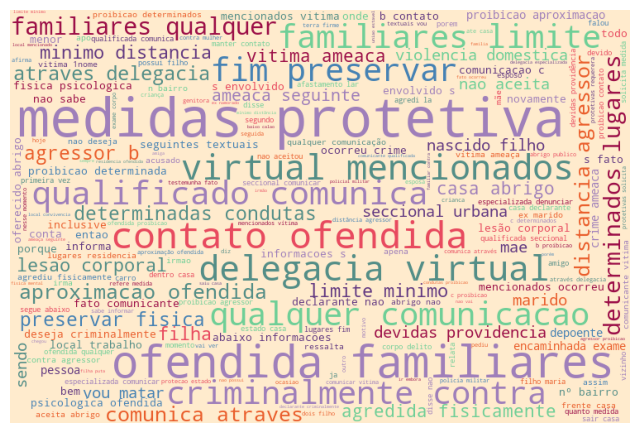

In [67]:
nltk.download('stopwords')
nltk.download('punkt')

text_all = ' '.join([relato.lower().strip() for relato in crimes_selecionados_belem_df['relato']])
words = word_tokenize(text_all)

stopwords_pt = set(nltk.corpus.stopwords.words('portuguese'))

outras_palavras_nao_interessantes = ["dia", "hora", "volta", "belem", "registra",  
                                     "acima", "fixando", "relato", "compareceu", "volta", "anos", 
                                     "idade", "nesta", "conforme", "quais", "poi", "mesma", "nbsp", "pc",
                                     "pa", "devidos", "testemunhas", "meio", "data", "frequentar","rg", "residente",
                                     "fins", "agressor b", "ainda", "qualquer comunicacao", "tambem", "representa"]


crimes_selecionados_belem_df['relato'] = crimes_selecionados_belem_df['relato'].apply(lambda relato: ' '.join([word for word in word_tokenize(relato.lower().strip()) 
                                                                                                             if word not in stopwords_pt 
                                                                                                             and all(palavra not in word for palavra in outras_palavras_nao_interessantes)]))

# Texto filtrado para a nuvem de palavras
text_filtered = ' '.join(word for word in words if word not in stopwords_pt and not any(palavra in word for palavra in outras_palavras_nao_interessantes))

def custom_color_func(word, font_size, position, orientation, random_state=None, **kwargs):
    return np.random.choice(custom_palette)


# Criando a nuvem de palavras com cores personalizadas
wordcloud = WordCloud(width=750, height=500, background_color='#ffebcd', color_func=custom_color_func).generate(text_filtered)

plt.figure(figsize=(8, 8))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()